<div class="alert alert-block alert-info">

# Business Cases 1 - Hotel Customer Segmentation
    
Project by **Group O**:


In [1]:
import os
import numpy as np
import pandas as pd
# So we can see all columns
pd.set_option("display.max_columns", None)
from math import ceil
import matplotlib.pyplot as plt
from matplotlib import ticker
import seaborn as sns
import collections
#Visualisations
plt.rcParams['figure.dpi'] = 300
import plotly.express as px

# PCA
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, silhouette_samples, pairwise_distances
# Scaling and Encoding
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder
import category_encoders as ce
# Clustering
# K-Means
from sklearn.cluster import KMeans
#!pip install yellowbrick
from sklearn.datasets import make_blobs
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance
# Ignore warnings
import warnings
warnings.filterwarnings("ignore")



    
## 1. Data Understanding



### 1.1. Import the datasets

In [2]:
df = pd.read_csv("Case1_HotelCustomerSegmentation.csv", sep = ';')
df

,ID,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,RoomNights,DistributionChannel,MarketSegment,SRHighFloor,SRLowFloor,SRAccessibleRoom,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
0,1,PRT,52.0,440,0x2C371FD6CE12936774A139FD7430C624F1C4D5109CE6...,0x434FD3D59469C73AFEA087017FAF8CA2296493AEABDE...,59,292.00,82.3,1,0,2,6,4,Corporate,Corporate,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,PRT,NaN,1385,0x198CDB98BF37B6E23F9548C56A88B00912D65A9AA0D6...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,61,280.00,53.0,0,0,1,10,5,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
2,3,DEU,32.0,1385,0xDA46E62F66936284DF2844EC4FC542D0DAD780C0EE0C...,0x27F5DF762CCDA622C752CCDA45794923BED9F1B66300...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
3,4,FRA,61.0,1385,0xC45D4CD22C58FDC5FD0F95315F6EFA5A6E7149187D49...,0x8E59572913BB9B1E6CAA12FA2C8B7BF387B1D1F3432E...,93,240.00,60.0,0,0,1,10,5,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
4,5,FRA,52.0,1385,0xD2E3D5BFCA141865669F98D64CDA85AD04DEFF47F8A0...,0x42BDEE0E05A9441C94147076EDDCC47E604DA5447DD4...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111728,111729,DEU,31.0,36,0x2F59F0E86596B861C3303585FDB7F090B1B2D70442C5...,0x86AC02B9393E7F58354BA4193D792C07DB91D4BE27C7...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,1,0,0,0,0,0
111729,111730,BRA,43.0,36,0x2708B9F11C95F384129152CDF0830B566F02D42B87AC...,0xE87DEB08B0D7D0BDC590949FF04AAA893018BD8EB714...,170,755.25,20.0,0,0,1,10,5,Travel Agent/Operator,Other,0,0,0,0,0,0,0,1,0,0,0,0,0
111730,111731,BRA,37.0,36,0xEF5F6AAA6120F2AC49179E16FD12477C243A8F4FC504...,0x74B9B5A554F5F660371E56D4CE4C1D4C3DC80AE71D68...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Other,0,0,0,0,0,0,0,1,0,0,0,0,0
111731,111732,DEU,48.0,36,0xC70AE03F615CB96B0C84CF29419C2DDFE8EC64B77104...,0xF589C016E6988AECD3E3BE793E7D606BBDB6B6D4795C...,66,708.00,185.0,0,0,1,8,4,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0


In [3]:
df.set_index('ID', inplace = True)
df

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,RoomNights,DistributionChannel,MarketSegment,SRHighFloor,SRLowFloor,SRAccessibleRoom,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,PRT,52.0,440,0x2C371FD6CE12936774A139FD7430C624F1C4D5109CE6...,0x434FD3D59469C73AFEA087017FAF8CA2296493AEABDE...,59,292.00,82.3,1,0,2,6,4,Corporate,Corporate,0,0,0,0,0,0,0,0,0,0,0,0,0
2,PRT,NaN,1385,0x198CDB98BF37B6E23F9548C56A88B00912D65A9AA0D6...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,61,280.00,53.0,0,0,1,10,5,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
3,DEU,32.0,1385,0xDA46E62F66936284DF2844EC4FC542D0DAD780C0EE0C...,0x27F5DF762CCDA622C752CCDA45794923BED9F1B66300...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
4,FRA,61.0,1385,0xC45D4CD22C58FDC5FD0F95315F6EFA5A6E7149187D49...,0x8E59572913BB9B1E6CAA12FA2C8B7BF387B1D1F3432E...,93,240.00,60.0,0,0,1,10,5,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
5,FRA,52.0,1385,0xD2E3D5BFCA141865669F98D64CDA85AD04DEFF47F8A0...,0x42BDEE0E05A9441C94147076EDDCC47E604DA5447DD4...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111729,DEU,31.0,36,0x2F59F0E86596B861C3303585FDB7F090B1B2D70442C5...,0x86AC02B9393E7F58354BA4193D792C07DB91D4BE27C7...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,1,0,0,0,0,0
111730,BRA,43.0,36,0x2708B9F11C95F384129152CDF0830B566F02D42B87AC...,0xE87DEB08B0D7D0BDC590949FF04AAA893018BD8EB714...,170,755.25,20.0,0,0,1,10,5,Travel Agent/Operator,Other,0,0,0,0,0,0,0,1,0,0,0,0,0
111731,BRA,37.0,36,0xEF5F6AAA6120F2AC49179E16FD12477C243A8F4FC504...,0x74B9B5A554F5F660371E56D4CE4C1D4C3DC80AE71D68...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Other,0,0,0,0,0,0,0,1,0,0,0,0,0


In [4]:
df.shape

(111733, 28)

In [5]:
pd.set_option("display.max_columns", 50)

df.head()

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,RoomNights,DistributionChannel,MarketSegment,SRHighFloor,SRLowFloor,SRAccessibleRoom,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,PRT,52.0,440,0x2C371FD6CE12936774A139FD7430C624F1C4D5109CE6...,0x434FD3D59469C73AFEA087017FAF8CA2296493AEABDE...,59,292.0,82.3,1,0,2,6,4,Corporate,Corporate,0,0,0,0,0,0,0,0,0,0,0,0,0
2,PRT,NaN,1385,0x198CDB98BF37B6E23F9548C56A88B00912D65A9AA0D6...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,61,280.0,53.0,0,0,1,10,5,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
3,DEU,32.0,1385,0xDA46E62F66936284DF2844EC4FC542D0DAD780C0EE0C...,0x27F5DF762CCDA622C752CCDA45794923BED9F1B66300...,0,0.0,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
4,FRA,61.0,1385,0xC45D4CD22C58FDC5FD0F95315F6EFA5A6E7149187D49...,0x8E59572913BB9B1E6CAA12FA2C8B7BF387B1D1F3432E...,93,240.0,60.0,0,0,1,10,5,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
5,FRA,52.0,1385,0xD2E3D5BFCA141865669F98D64CDA85AD04DEFF47F8A0...,0x42BDEE0E05A9441C94147076EDDCC47E604DA5447DD4...,0,0.0,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0


### 1.2. Variable types

In [6]:
df.info()


<class 'pandas.core.frame.DataFrame'>
Index: 111733 entries, 1 to 111733
Data columns (total 28 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Nationality           111733 non-null  object 
 1   Age                   107561 non-null  float64
 2   DaysSinceCreation     111733 non-null  int64  
 3   NameHash              111733 non-null  object 
 4   DocIDHash             110732 non-null  object 
 5   AverageLeadTime       111733 non-null  int64  
 6   LodgingRevenue        111733 non-null  float64
 7   OtherRevenue          111733 non-null  float64
 8   BookingsCanceled      111733 non-null  int64  
 9   BookingsNoShowed      111733 non-null  int64  
 10  BookingsCheckedIn     111733 non-null  int64  
 11  PersonsNights         111733 non-null  int64  
 12  RoomNights            111733 non-null  int64  
 13  DistributionChannel   111733 non-null  object 
 14  MarketSegment         111733 non-null  object 
 15  SRHig

Based on this information, the variables `Age` and `DocIDHash` contain missing values. As for the variable types, everything appears to be in order.


### 1.3. Descriptive statistics

In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,107561.0,45.639191,17.244952,-10.0,33.0,47.0,58.0,123.00
DaysSinceCreation,111733.0,595.026599,374.657382,36.0,288.0,522.0,889.0,1385.00
AverageLeadTime,111733.0,60.833147,85.115320,-1.0,0.0,21.0,95.0,588.00
LodgingRevenue,111733.0,283.851283,379.131556,0.0,0.0,208.0,393.3,21781.00
OtherRevenue,111733.0,64.682802,123.580715,0.0,0.0,31.0,84.0,8859.25
BookingsCanceled,111733.0,0.002282,0.080631,0.0,0.0,0.0,0.0,15.00
BookingsNoShowed,111733.0,0.000600,0.028217,0.0,0.0,0.0,0.0,3.00
BookingsCheckedIn,111733.0,0.737607,0.730889,0.0,0.0,1.0,1.0,76.00
PersonsNights,111733.0,4.328318,4.630739,0.0,0.0,4.0,6.0,116.00
RoomNights,111733.0,2.203825,2.301637,0.0,0.0,2.0,3.0,185.00


**KEY OBSERVATIONS:**

- **`Age`** - Some records indicate negative ages and individuals over 100 years old, which is quite uncommon. This could suggest data entry or imputation errors by the hotel.  

- **`DaysSinceCreation`** - This variable appears to have potential outliers, as its maximum value is significantly higher than the 75th percentile. However, despite these possible outliers, they could still represent genuine patterns.  

- **`AverageLeadTime`** - Negative values are present, which we believe is not an ideal scenario. Additionally, the highest recorded lead time is 588 days (indicating at least one booking was made almost two years in advance), whereas the 75th percentile is just 95 days. While this might be a legitimate case, our team considers it an outlier and may exclude it in further analysis.  

- **`LodgingRevenue`** - The highest recorded value is **21,781**, whereas the 75th percentile is only **393**, suggesting the presence of outliers in this variable.  

- **`OtherRevenue`** - The maximum value reaches **8,859.35**, while the 75th percentile is only **84**, which indicates potential outliers in this feature.  

- **`BookingsCanceled`** - The peak value is **15**, while the 75th percentile remains at **0**, which likely points to the existence of outliers.  

- **`BookingsCheckedIn`** - The highest observed value is **76**, whereas the 75th percentile is just **1**, suggesting possible outliers in this variable.  

- **`PersonsNights`** - The maximum value reaches **116**, with the 75th percentile at only **6**, which may indicate outliers.  

- **`RoomNights`** - The highest value is **185**, while the 75th percentile is merely **3**, implying the presence of potential outliers in this dataset.  


In [8]:
# Checking the descriptive statistics of the categorical features
df.describe(include="object").T

,count,unique,top,freq
Nationality,111733,199,FRA,16516
NameHash,111733,107584,0x15A713CE687991691A18F6CDC56ABE24979C73CF5D51...,75
DocIDHash,110732,103480,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,3032
DistributionChannel,111733,4,Travel Agent/Operator,91019
MarketSegment,111733,7,Other,63680


**KEY OBSERVATIONS:**


- **`Nationality`** - The dataset contains **199 unique nationalities**, with **France (FRA) being the most common**. This suggests that while the hotel serves a diverse clientele, a significant portion of guests come from a single country.  

- **`NameHash`** - There are **107,584 unique hashed names**, though some names repeat, with the most frequent one appearing **75 times**. This could indicate common names, duplicate entries, or multiple accounts for the same individual.  

- **`DocIDHash`** - This identifier, which should be unique per customer, shows **1,001 missing values** and a repeated hash **over 3,000 times**. This suggests potential **missing values or improper encoding** that should be reviewed.  

- **`DistributionChannel`** - Bookings are primarily made through **four distribution channels**, with **"Travel Agent/Operator" being the most frequent (81%)**. This indicates a **heavy reliance on third-party intermediaries**, which may impact direct revenue control.  

- **`MarketSegment`** - The dataset includes **seven market segments**, but **"Other" accounts for 57% of entries**. This suggests **poorly defined segmentation** or potential misclassification, making it harder to derive meaningful insights from customer behavior.  

---

**KEY TAKEAWAYS:**


- **French guests dominate the customer base**, though the hotel serves a highly diverse audience.  
- **NameHash and DocIDHash** reveal potential **duplicate entries or missing values**.  
- **Bookings are primarily made through travel agents**, reducing direct interactions with customers.  
- **Market segmentation is unclear**, with over half of customers falling into an undefined category.  
- **Encoding of nationality should be optimized** to avoid high-dimensionality issues.  


### 1.4. Data Visualizations

We can begin by categorizing the variables based on their data types.

In [9]:
metric_features = ["Age","DaysSinceCreation","AverageLeadTime","LodgingRevenue","OtherRevenue","BookingsCanceled","BookingsNoShowed","BookingsCheckedIn","PersonsNights","RoomNights"]
non_metric_features = df.columns.drop(metric_features).to_list()

# For now, let's keep binary features (all "SR" variables) separated from the remaining categorical ones.
binary_features = ["SRHighFloor", "SRLowFloor", "SRAccessibleRoom", "SRMediumFloor", "SRBathtub", "SRShower", "SRCrib",
                   "SRKingSizeBed", "SRTwinBed", "SRNearElevator", "SRAwayFromElevator", "SRNoAlcoholInMiniBar", "SRQuietRoom"]

#### Age

In [10]:
df['Age'].value_counts(dropna=False)

Age
NaN      4172
51.0     2582
52.0     2561
55.0     2557
50.0     2504
         ... 
115.0       2
123.0       1
97.0        1
110.0       1
95.0        1
Name: count, Length: 107, dtype: int64

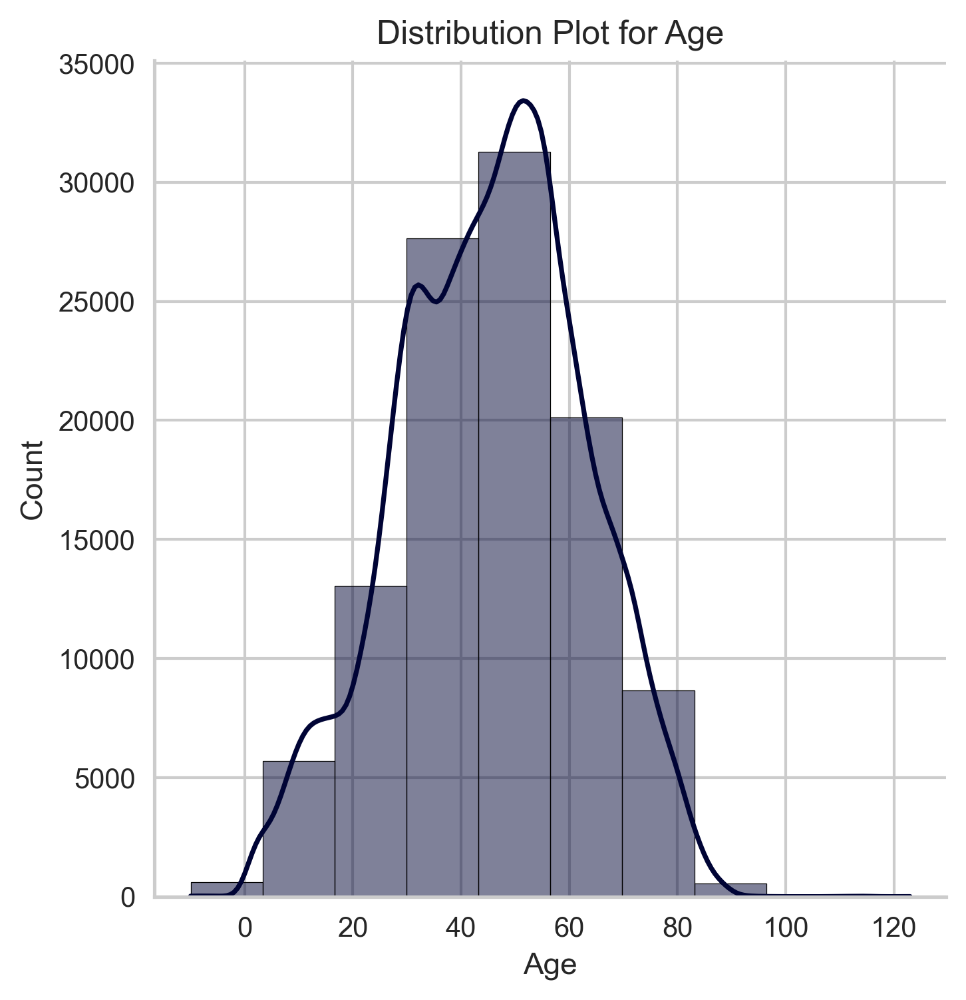

In [11]:
sns.displot(x=df["Age"], kind="hist", kde=True, color="#000435", bins=10)
plt.title(f'Distribution Plot for Age')
plt.xlabel('Age')
plt.ylabel("Count")
plt.show()

#### Days Since Creation

In [12]:
df['DaysSinceCreation'].value_counts(dropna=False)

DaysSinceCreation
502     298
522     247
108     234
312     234
137     232
       ... 
1377      5
1370      4
1363      4
763       3
1209      1
Name: count, Length: 1349, dtype: int64

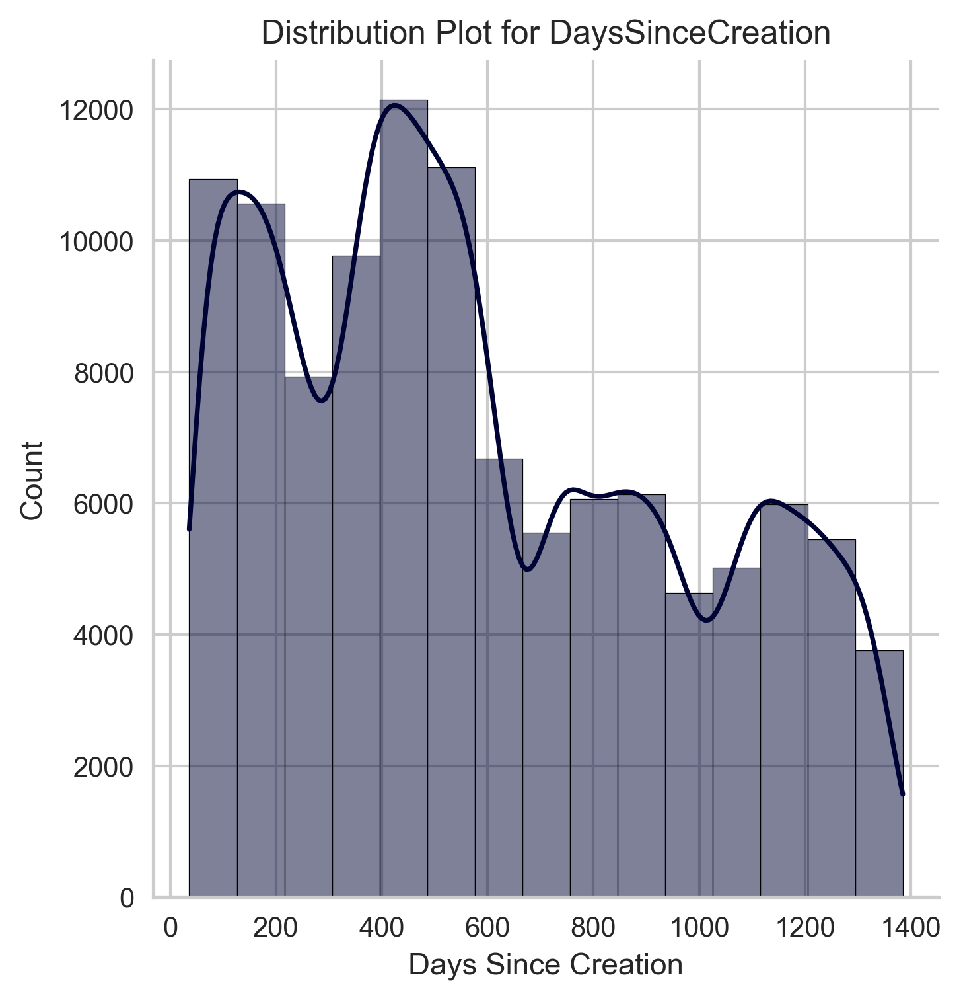

In [13]:
sns.displot(x=df["DaysSinceCreation"], kind="hist", kde=True, color="#000435", bins=15)
plt.title(f'Distribution Plot for DaysSinceCreation')
plt.xlabel('Days Since Creation')
plt.ylabel("Count")
plt.show()

#### NameHash

In [14]:
df["NameHash"].duplicated().sum()

4149

#### DocIDHash

In [15]:
df["DocIDHash"].duplicated().sum()

8252

In [16]:
# A missing DocIDHash indicates that the client did not check in. 
# To identify inconsistencies, let's verify if there are any records where 
# DocIDHash is missing but the customer has BookingsCheckedIn > 0. 
# If such cases exist, they could be due to a system error in the hotel's data.

df[(df["DocIDHash"].isna()) & (df["BookingsCheckedIn"] > 0)]

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,RoomNights,DistributionChannel,MarketSegment,SRHighFloor,SRLowFloor,SRAccessibleRoom,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,
59,PRT,NaN,1385,0x51764F97FD9E3426C98D7DFEFE3A2A2D3C724089ECFB...,NaN,0,0.0,2.00,0,0,2,2,2,Direct,Complementary,0,0,0,0,0,0,0,0,0,0,0,0,0
945,PRT,NaN,1350,0xCDA04881493C308AD327EC8BD0CF014DD514E90F48B9...,NaN,0,54.0,42.00,0,0,2,6,4,Direct,Direct,0,0,0,0,0,0,0,0,0,0,0,0,0
20497,PRT,NaN,1020,0xC6E889DC7511C94DB21A4BA17711C5AFB56C18B9AB9B...,NaN,9,0.0,39.00,0,0,2,6,3,Direct,Complementary,0,0,0,0,0,0,0,1,0,0,0,0,0
35430,PRT,NaN,780,0xAAD113AA0A812CB11CF085F14B8AB57A1DA6F433D338...,NaN,4,1852.0,361.92,0,0,2,6,4,Direct,Direct,0,0,0,0,0,0,0,0,0,0,0,0,0


#### AverageLeadTime

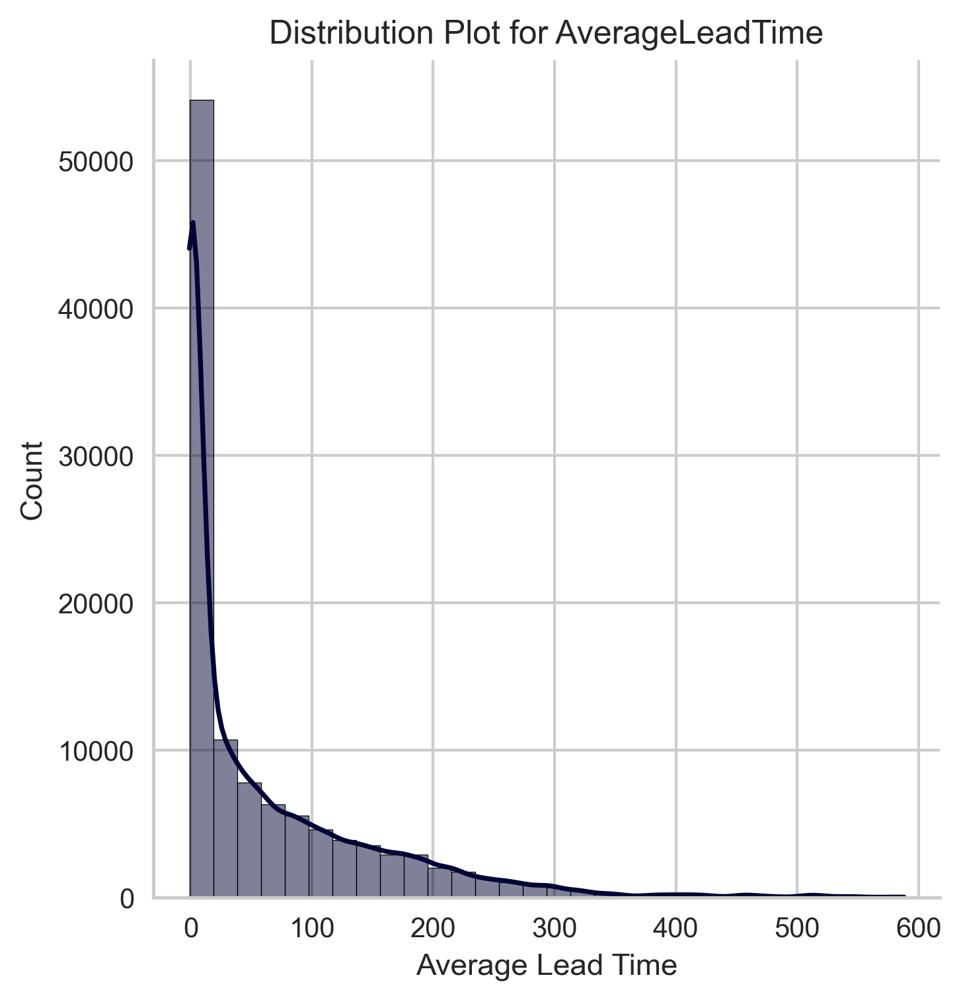

In [17]:
sns.displot(x=df["AverageLeadTime"], kind="hist", kde=True, color="#000435", bins=30)
plt.title(f'Distribution Plot for AverageLeadTime')
plt.xlabel('Average Lead Time')
plt.ylabel("Count")
plt.show()

In [18]:
print("Number of people with AverageLeadTime = 0:", len(df[df['AverageLeadTime'] == 0]))

Number of people with AverageLeadTime = 0: 36678


A high number of same-day hotel bookings (36,678 cases) can be explained by several factors. Many travelers book on arrival as walk-in guests, especially in budget hotels and city centers, preferring flexibility or comparing prices in person. Flight cancellations or delays also contribute, as stranded passengers need last-minute accommodations, particularly near airports. Additionally, hotel overbookings or relocations lead to unexpected same-day reservations when guests are transferred between properties. 

#### LodgingRevenue

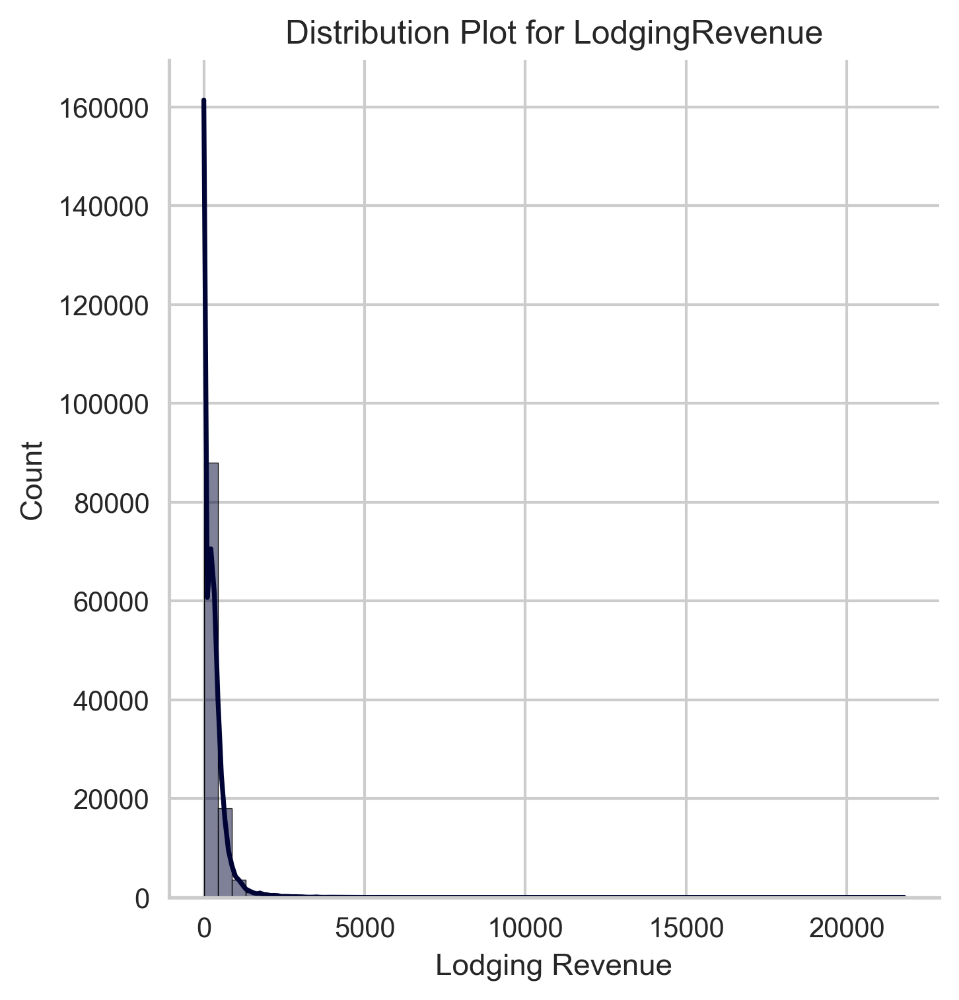

In [19]:
sns.displot(x=df["LodgingRevenue"], kind="hist", kde=True, color="#000435", bins=50)
plt.title(f'Distribution Plot for LodgingRevenue')
plt.xlabel('Lodging Revenue')
plt.ylabel("Count")
plt.show()

possivel explicação de tantos zeros e a existencia de outliers.........

In [20]:
# Count of customers with zero lodging revenue who canceled or no-showed
zero_revenue_canceled = df[(df['LodgingRevenue'] == 0) & (df['BookingsCanceled'] > 0)]
zero_revenue_noshowed = df[(df['LodgingRevenue'] == 0) & (df['BookingsNoShowed'] > 0)]

print("Customers with LodgingRevenue = 0 and at least one cancellation:", len(zero_revenue_canceled))
print("Customers with LodgingRevenue = 0 and at least one no-show:", len(zero_revenue_noshowed))


Customers with LodgingRevenue = 0 and at least one cancellation: 17
Customers with LodgingRevenue = 0 and at least one no-show: 0


In [21]:
# Count of customers with zero lodging revenue but non-zero other revenue
zero_revenue_other_spending = df[(df['LodgingRevenue'] == 0) & (df['OtherRevenue'] > 0)]

print("Customers with LodgingRevenue = 0 but spent on other services:", len(zero_revenue_other_spending))

Customers with LodgingRevenue = 0 but spent on other services: 232


#### Other Revenue

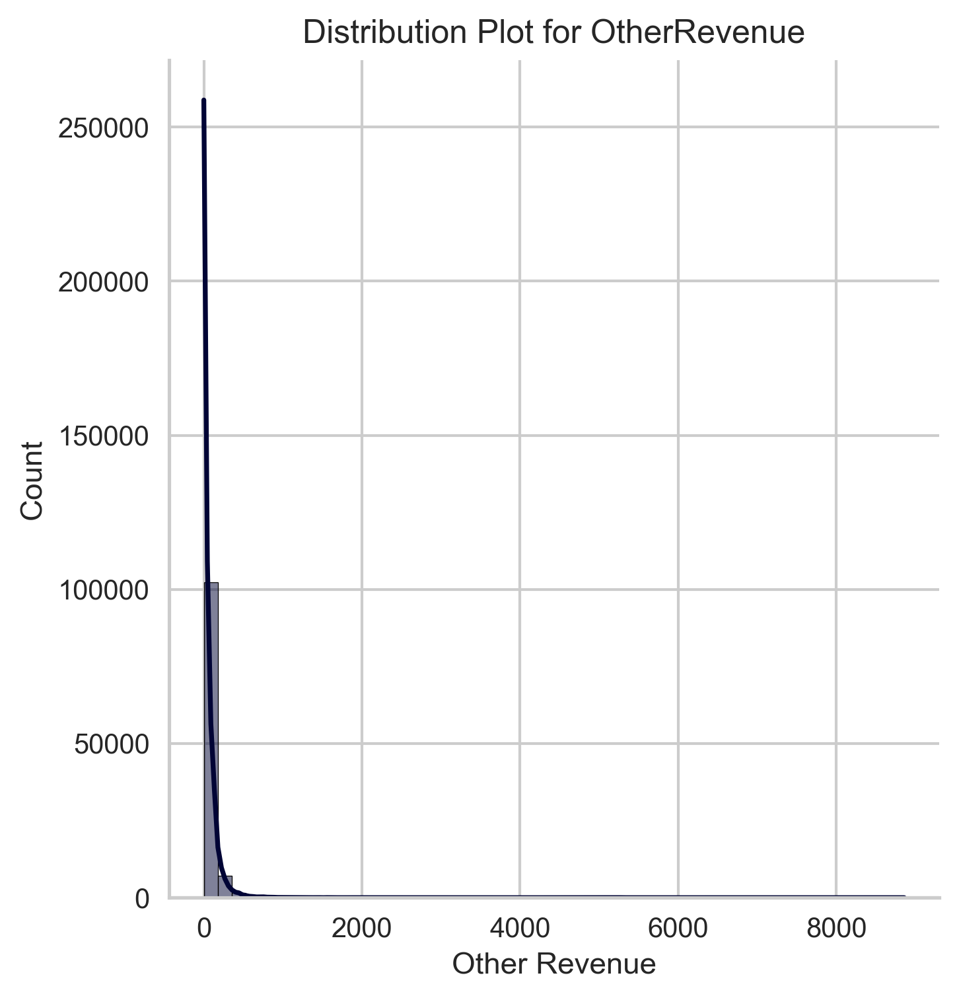

In [22]:
sns.displot(x=df["OtherRevenue"], kind="hist", kde=True, color="#000435", bins=50)
plt.title(f'Distribution Plot for OtherRevenue')
plt.xlabel('Other Revenue')
plt.ylabel("Count")
plt.show()

#### BookingsCanceled

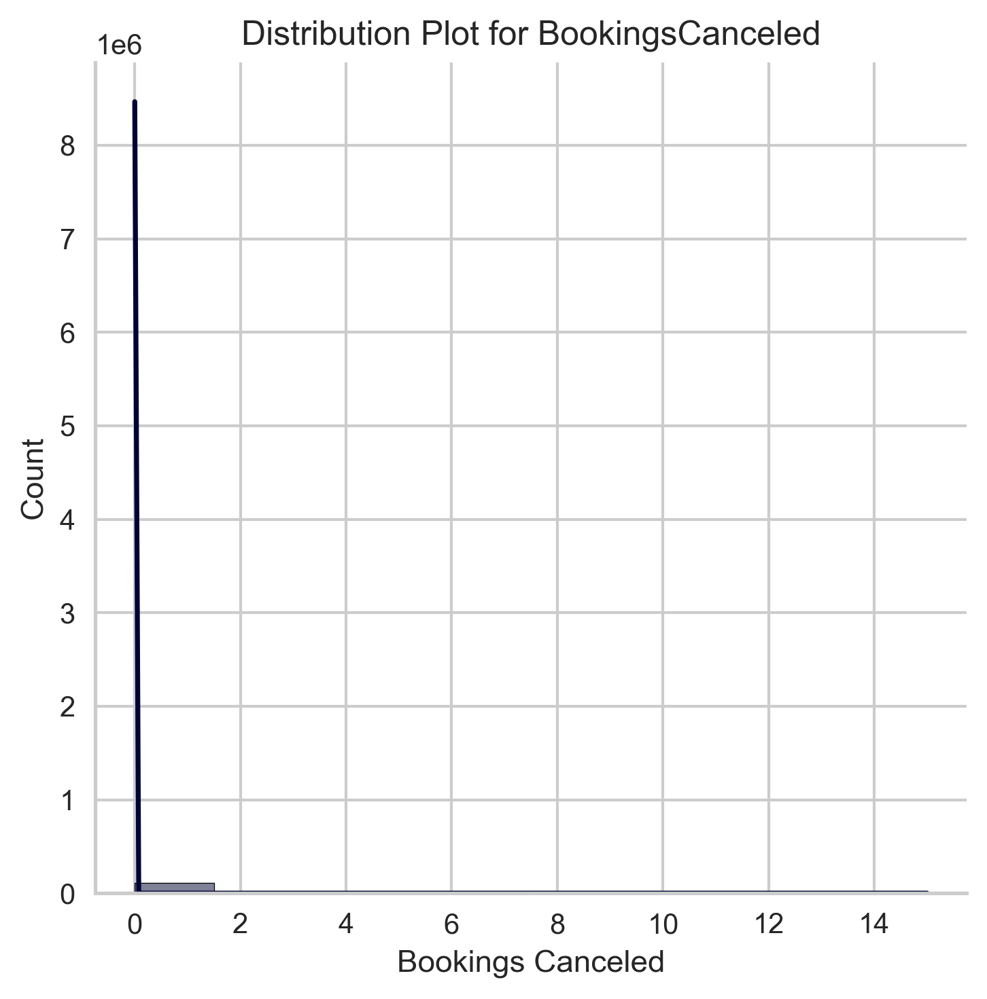

In [23]:
sns.displot(x=df["BookingsCanceled"], kind="hist", kde=True, color="#000435", bins=10)
plt.title(f'Distribution Plot for BookingsCanceled')
plt.xlabel('Bookings Canceled')
plt.ylabel("Count")
plt.show()

#### BookingsNoShowed

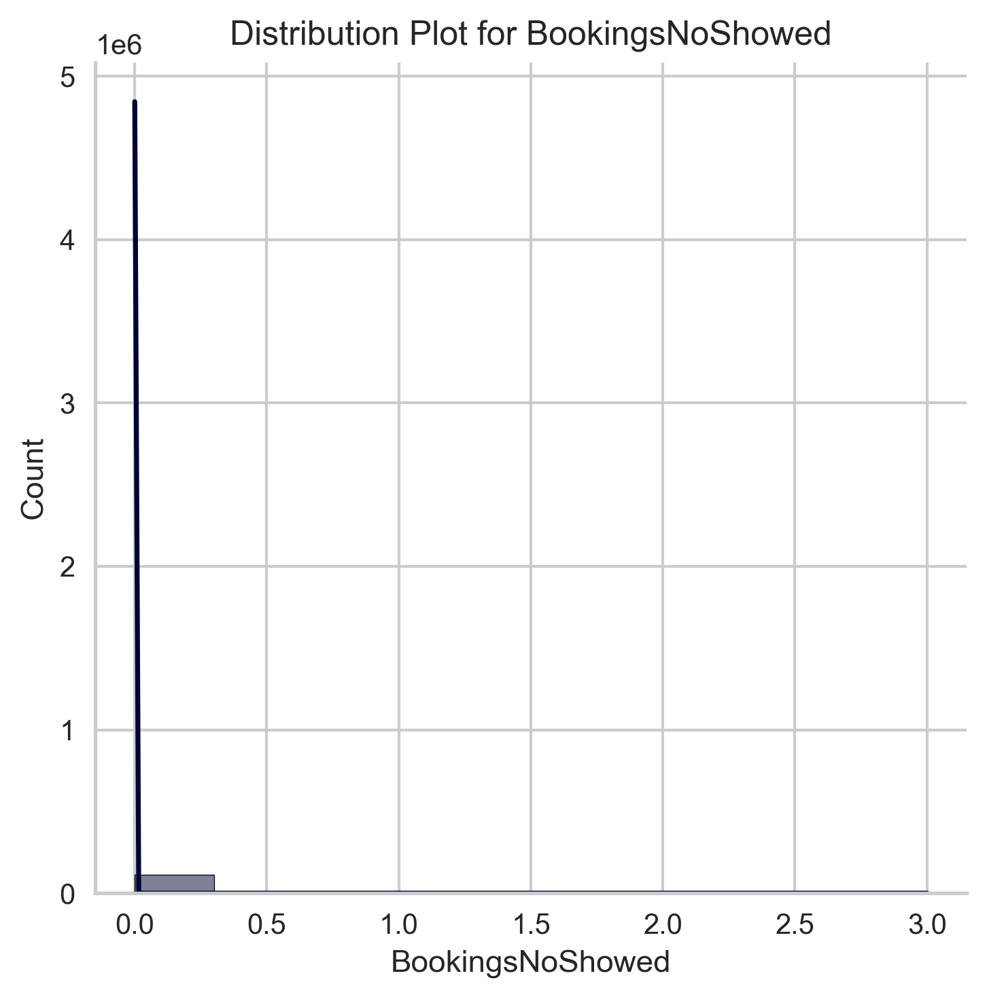

In [24]:
sns.displot(x=df["BookingsNoShowed"], kind="hist", kde=True, color="#000435", bins=10)
plt.title(f'Distribution Plot for BookingsNoShowed')
plt.xlabel('BookingsNoShowed')
plt.ylabel("Count")
plt.show()

Cancellations are more frequent than no-shows, which makes sense as canceling is an intentional action, while no-shows may happen due to unexpected circumstances. Both distributions are heavily right-skewed, meaning very few customers repeatedly cancel or fail to show up.

#### BookingsCheckedIn

#### PersonNights

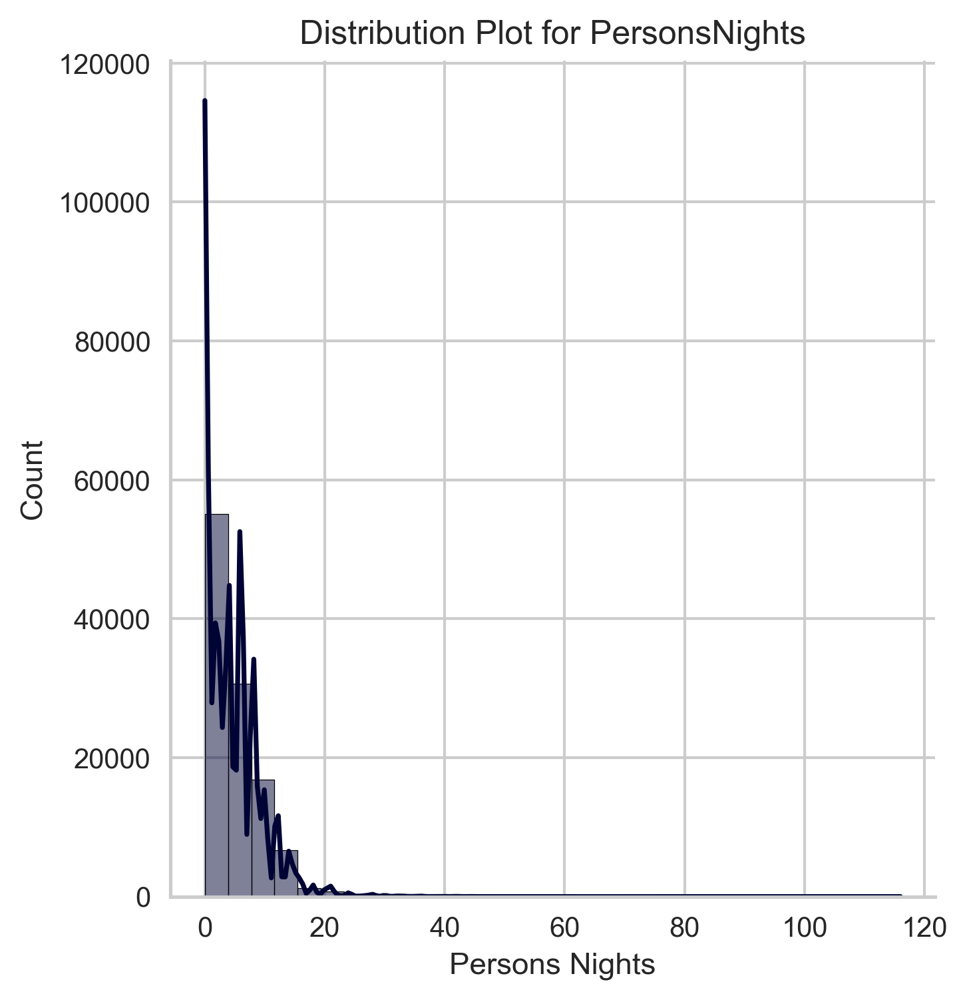

In [25]:
sns.displot(x=df["PersonsNights"], kind="hist", kde=True, color="#000435", bins=30)
plt.title(f'Distribution Plot for PersonsNights')
plt.xlabel('Persons Nights')
plt.ylabel("Count")
plt.show()

In [26]:
df["PersonsNights"].value_counts()

PersonsNights
0      33202
6      16328
4      12926
2      11815
8      10245
1       5147
3       4964
10      4296
12      3931
9       2253
14      1845
5       1116
15       864
16       659
18       492
21       412
7        291
20       276
24       161
28        91
30        53
22        51
11        45
27        41
32        24
26        23
13        22
33        21
36        21
17        18
19        14
25        12
42         9
23         8
35         7
40         6
34         5
39         5
44         4
48         3
38         3
45         2
29         2
31         2
68         2
51         2
80         1
59         1
91         1
37         1
57         1
41         1
49         1
52         1
116        1
56         1
99         1
75         1
62         1
60         1
Name: count, dtype: int64

Around 33,000 records have PersonsNights = 0, which is unexpected since this variable is calculated as (Adults + Children) × Length of Stay. The presence of so many zero values suggests potential cancellations, no-shows, missing data, or customers who only used hotel services without staying overnight. Further analysis, such as checking their LodgingRevenue, BookingsCanceled, and BookingsNoShowed values, could help determine the exact cause.

In [27]:
# Count of customers with PersonsNights = 0 and LodgingRevenue = 0
zero_persons_nights_revenue = df[(df["PersonsNights"] == 0) & (df["LodgingRevenue"] == 0)]

print("Customers with PersonsNights = 0 and LodgingRevenue = 0:", len(zero_persons_nights_revenue))


Customers with PersonsNights = 0 and LodgingRevenue = 0: 33197


In [28]:
# Count of customers with PersonsNights = 0 and at least one cancellation
zero_persons_nights_canceled = df[(df["PersonsNights"] == 0) & (df["BookingsCanceled"] > 0)]

# Count of customers with PersonsNights = 0 and at least one no-show
zero_persons_nights_noshowed = df[(df["PersonsNights"] == 0) & (df["BookingsNoShowed"] > 0)]

print("Customers with PersonsNights = 0 and at least one cancellation:", len(zero_persons_nights_canceled))
print("Customers with PersonsNights = 0 and at least one no-show:", len(zero_persons_nights_noshowed))


Customers with PersonsNights = 0 and at least one cancellation: 1
Customers with PersonsNights = 0 and at least one no-show: 0


In [29]:
# Count of customers with PersonsNights = 0 but spent on other services
zero_persons_nights_other_revenue = df[(df["PersonsNights"] == 0) & (df["OtherRevenue"] > 0)]

print("Customers with PersonsNights = 0 but spent on other services:", len(zero_persons_nights_other_revenue))


Customers with PersonsNights = 0 but spent on other services: 5


The analysis shows that **33,197 customers have `PersonsNights = 0` and `LodgingRevenue = 0`**, meaning they **never stayed at the hotel and never paid for lodging**. Surprisingly, **only 1 case is linked to a cancellation and 0 to a no-show**, ruling out booking failures as the main cause. Additionally, **only 5 of these customers spent money on other hotel services**, indicating they are not just spa or restaurant visitors. This suggests that most of these records likely belong to **customers who registered but never booked**.








#### RoomNights

In [30]:
df["RoomNights"].value_counts()

RoomNights
0      33198
3      20706
2      17484
4      14050
1      13665
5       6248
7       2570
6       2424
8        505
9        271
10       199
11        97
12        71
14        53
15        36
13        34
19        14
17        13
16        13
21        12
18        10
22         8
26         6
24         4
28         4
32         3
20         3
31         3
42         2
40         2
33         2
37         2
39         2
88         2
51         2
36         2
25         1
48         1
49         1
27         1
95         1
35         1
30         1
185        1
34         1
23         1
29         1
116        1
59         1
Name: count, dtype: int64

In [31]:
# Count of customers with RoomNights = 0 and LodgingRevenue = 0
zero_room_nights_revenue = df[(df["RoomNights"] == 0) & (df["LodgingRevenue"] == 0)]

print("Customers with RoomNights = 0 and LodgingRevenue = 0:", len(zero_room_nights_revenue))


Customers with RoomNights = 0 and LodgingRevenue = 0: 33197


The variables **`PersonsNights`** and **`RoomNights`** are highly similar because they both depend on the **length of stay** in a booking. `RoomNights` is calculated as **(number of rooms) × (length of stay)**, while `PersonsNights` is **(number of guests) × (length of stay)**. Since both are based on the total number of nights, it makes sense that they have the same number of **zero values (33,197 records)**. This confirms that these customers **never stayed at the hotel and never paid for lodging (`LodgingRevenue = 0`)**, likely due to incomplete bookings, inactive accounts, or system records.

#### DistributionChannel

Text(0, 0.5, 'Count')

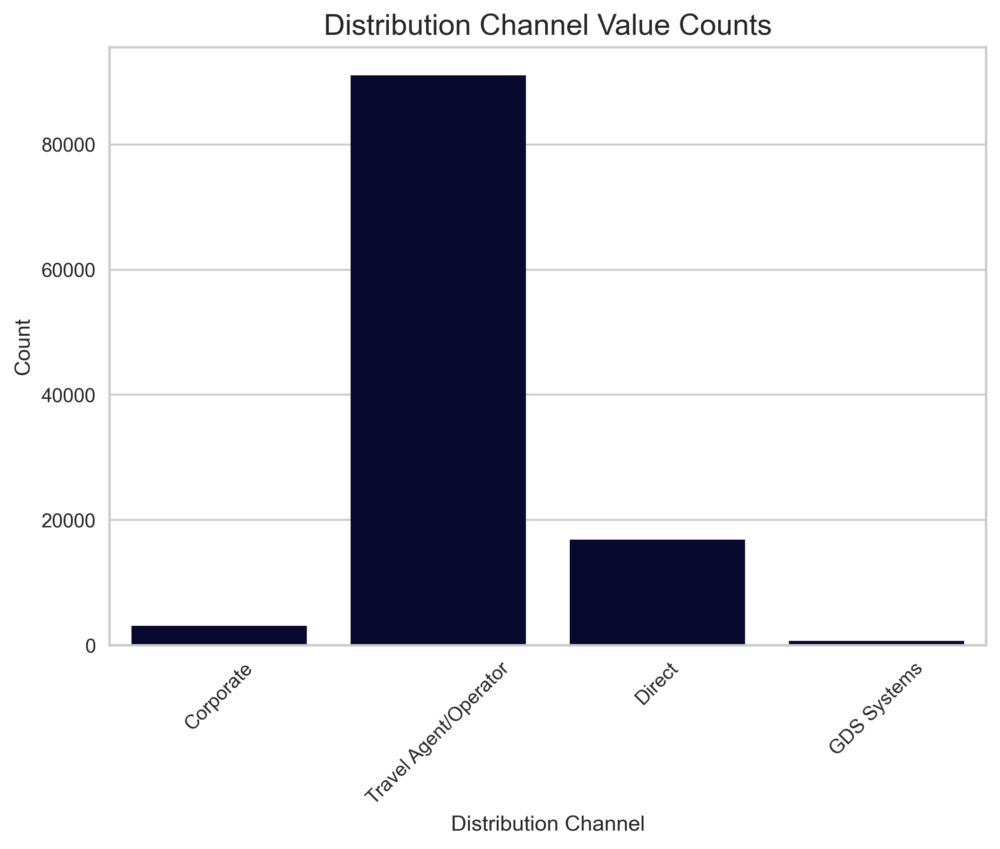

In [32]:
# Visualizing the information shown above will allow for a more clear understanding of the data
sns.countplot(x = df["DistributionChannel"], color = "#000435")
plt.title("Distribution Channel Value Counts", size = 15)
plt.xlabel("Distribution Channel")
plt.xticks(rotation=45)
plt.ylabel("Count")

#### MarketSegment

Text(0, 0.5, 'Count')

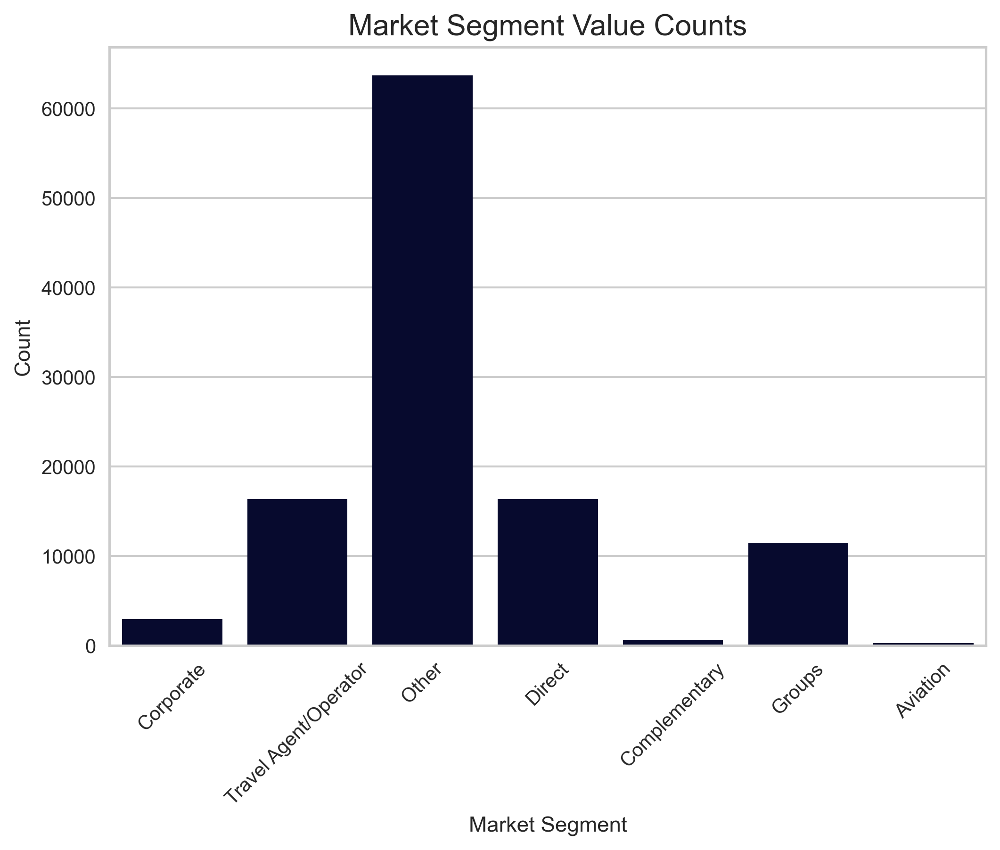

In [33]:
# Visualizing the information shown above will allow for a more clear understanding of the data
sns.countplot(x = df["MarketSegment"], color = "#000435")
plt.title("Market Segment Value Counts", size = 15)
plt.xlabel("Market Segment")
plt.xticks(rotation=45)
plt.ylabel("Count")

#### Nationality

In [34]:
# Let's create a copy of the original dataframe for this plot so that we don't mess anything up by accident
df_nationality_plot = df.copy()

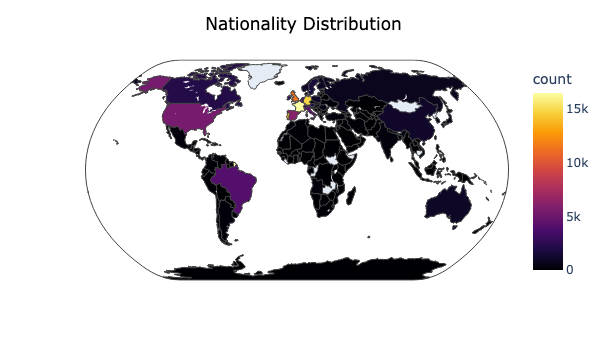

In [35]:
nationality_counts = df_nationality_plot['Nationality'].value_counts().reset_index()
nationality_counts.columns = ['iso_alpha', 'count']

fig = px.choropleth(data_frame = nationality_counts, locations = 'iso_alpha', color = 'count', hover_name = 'iso_alpha',
                    color_continuous_scale = px.colors.sequential.Inferno, projection = 'natural earth')
fig.update_layout(title_text = 'Nationality Distribution', title_x = 0.5, title_font = dict(color = 'black'))
fig.show()

Now, we can clearly see that, besides Europe (mainly France, Germany, the UK, Portugal, Spain and Italy), the Brazilian market is also one where many of the hotel's customers can be found. Additionally, North America (with the US but also Canada) is a region of relevance when it comes to the nationality of the customers.

In [36]:
df['Nationality'].value_counts()

Nationality
FRA    16516
DEU    14805
PRT    14101
GBR    11462
ESP     6123
       ...  
BHS        1
TMP        1
TZA        1
PNG        1
BDI        1
Name: count, Length: 199, dtype: int64

#### Binary Variables ("SR")

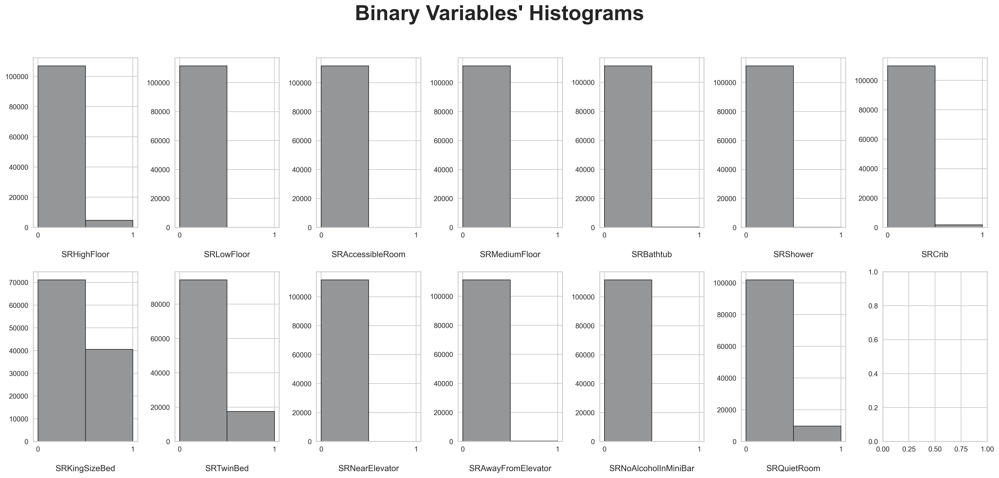

In [37]:
# Prepare figure with individual axes for each histogram
fig, axes = plt.subplots(2, np.ceil(len(binary_features) / 2).astype(int), figsize=(20, 10))

# Plot data
for ax, feat in zip(axes.flatten(), binary_features):
    ax.hist(df[feat], bins=2, color="#949698", ec="black", linewidth=0.7)  # Binary values (0 or 1) need only 2 bins
    ax.set_title(feat, y=-0.2)
    ax.set_xticks([0, 1])  # Ensuring x-axis only shows 0 and 1

# Layout adjustments
plt.suptitle("Binary Variables' Histograms", size=30, fontweight="bold")
plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Ensures spacing for title
plt.show()

As observed, many features exhibit significant class imbalance, with the "1" value representing less than 1% of occurrences. At this stage, our group has considered two possible approaches: 

1. Combining all these features into a single variable for **Special Requests**.
2. Removing features with extreme class imbalance.

This issue will be addressed further during the **data preprocessing** stage.

## 2. Data Preparation

### 2.1. Duplicates

We're going to start our data preparation by looking at duplicates. It's highly unlikely that two customers may have the same behaviour in all the different variables. By combining Name with DocID we believe we can get a unique combination, allowing us to identify these duplicates more easily

In [38]:
# checking duplicate observations

df.duplicated().sum()

111

In [39]:
# Identifying rows that may have duplicated values
duplicates = df.duplicated(subset=["NameHash", "DocIDHash"])
df[duplicates]

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,RoomNights,DistributionChannel,MarketSegment,SRHighFloor,SRLowFloor,SRAccessibleRoom,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,
448,AGO,53.0,1376,0x05842189D4980DE3E463F1C49202001E6D433F246F48...,0x2A84DA7C5E0703A07903A23A1077A93D01F041FA3F50...,0,75.0,26.00,0,0,1,2,1,Direct,Direct,0,0,0,0,0,0,0,0,0,0,0,0,0
497,AGO,19.0,1371,0xCA45507F6EEBD2BF107402EB5EF7A82802CB8501F2D8...,0xD340880F2B5040688D70EA73262D977556D84542A66D...,0,0.0,0.00,0,0,0,0,0,Direct,Direct,0,0,0,0,0,0,0,0,0,0,0,0,0
574,FRA,39.0,1366,0x151534153AD90C917F2ECC4969626BEA37E66E0F85C3...,0xBDF406844F5C6F19839DEA4A9EF9B5496B5D4E2D07CC...,20,146.0,19.00,0,0,1,2,2,Corporate,Corporate,0,0,0,0,0,0,0,0,0,0,0,0,0
595,ROU,38.0,1365,0x71AD7B2E07CAD82195B968B7CDD7961EC953760899B5...,0x9CD129744684370C750190DB02D767653BB96C8119B3...,0,0.0,0.00,0,0,0,0,0,Travel Agent/Operator,Other,0,0,0,0,0,0,0,1,0,0,0,0,0
623,PRT,45.0,1364,0xA572ACFD6ED984560AD56A76021496F96C48CB03BA54...,0x8D9B0172FF7BC4BAFFF32BABC1C54FCA1207D33C2DB4...,0,493.0,46.00,0,0,1,1,1,Direct,Direct,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111323,LUX,8.0,40,0x855D1540E591F6640709E8BB6F6BE26F04EBEBD3510F...,0x6CF7256E1B20F60DA11D590BF376C205A10D23FA68B1...,0,0.0,0.00,0,0,0,0,0,Direct,Direct,0,0,0,0,0,0,0,0,0,0,0,0,0
111344,FRA,75.0,40,0x1441D0635E3493605030DEA783DAC8B924A3EE9A7298...,0x46AF3DF631BB4FA041D897E43A1679FD8F77E3793B6C...,0,0.0,0.00,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,1,0,0,0,0
111352,FRA,54.0,39,0x05ACC2AEB73F8A40BCDF90175DE9935D36F8D6632E60...,0x769F23C18265E2D8B03CE2EC6F6124C5BD000EE63198...,0,0.0,0.00,0,0,0,0,0,Direct,Direct,0,0,0,0,0,0,0,0,1,0,0,0,0


These duplicated values may indicate information regarding the same customers but were wrongly associated to another ClientID. We'll remove these duplicated rows but keep the customer data.

In [40]:
# Count total rows before removing duplicates
total_rows_before = df.shape[0]

# Remove duplicates based on NameHash and DocIDHash
df = df.drop_duplicates(subset=['NameHash', 'DocIDHash'], keep='last')

# Count total rows after removing duplicates
total_rows_after = df.shape[0]

# Calculate the percentage of removed rows
percentage_removed = ((total_rows_before - total_rows_after) / total_rows_before) * 100

print(f"Number of rows removed: {total_rows_before - total_rows_after}")
print(f"Percentage of total data removed: {percentage_removed:.2f}%")


Number of rows removed: 3381
Percentage of total data removed: 3.03%


### 2.2. Incoherencies

Incoherencies in data refer to values that are incorrect, inconsistent, or illogical in the dataset. They can happen due to human mistakes, formatting issues, among others. It's important to treat these incosistencies to get a clean and correct dataset to get working. In the first section of our notebook (1. Data Understanding) we were able to identify some of these incoherencies:

1. Customers whose `Age` is less than 0: it is not correct to have customers whose age is less than 0. Clients whose age is over 100 are also worth looking into;


2. Customers whose `AverageLeadTime` is less than 0: The presence of `-1` is likely due to a **misinput, missing data, or a system placeholder error** rather than a meaningful value. To handle this correctly, we will deleate `-1`;


3. Customers who haven't checked in at the Hotel for the last 3+ years: we believe that these customers might not provide very useful information, since they didn't come to the hotel for the last 3 years, and their present behaviour may be different;


4. The `MarketSegment` column is not useful anymore, it was the final classification of the previous model, which is not working anymore, othwerwise we wouldn't be making a new one;

5. The variables `NameHash` and `DocIDHash` function as unique identifiers for each customer, meaning they do not provide any valuable insights into customer behavior or booking patterns. Since the objective of this project is to define customer segments based on meaningful characteristics, these variables do not contribute to the analysis and can be discarded. Additionally, because they are in a hashed format, it is not possible to decode them or extract any useful information.


6. Since individuals under the age of 18 are not legally allowed to book a hotel in Portugal, any records with `Age < 18` will be removed from the dataset.

Source for confirming that people under 18 cannot make book a hotel in Portugal:
[Logitravel](https://www.logitravel.pt/perguntas-frequentes/hoteis-qual-e-a-idade-minima-para-poder-reservar-um-hotel-8_509.html)


**1. Customers whose `Age` is less than 0**

In [41]:
# clients with "negative" age
df.loc[df["Age"]<0]

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,RoomNights,DistributionChannel,MarketSegment,SRHighFloor,SRLowFloor,SRAccessibleRoom,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2053,BIH,-6.0,1324,0xB715504C2E85AA4DDCA6A8B149CB79F73F401C5344A0...,0x9ED63F460C900B662B890A825398EA74E2AB649383BB...,0,0.00,0.00,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
2469,ATF,-6.0,1319,0x37BDAE928BB1B43CF2DF052D72361EDEB60912B1CEB5...,0x335624ED7784B64693ACA7AE496D17AB8B4D1FECB0FA...,0,0.00,0.00,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
5128,FRA,-8.0,1271,0x98C0A7B15C1EFE465B2F49992DDB2AEEBD6E36544A8D...,0x8E0392C5D36615A020644CC4B910B7F95C4CA6E919E0...,66,93.30,14.00,0,0,1,2,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,1,0,0,0,0,0
6752,GBR,-10.0,1243,0x8CCCC4A546151AF5A0B1AFF3217ED72A8AC7E3057BD2...,0xE4BA150277C08ADEE04304BE69BBB15790BD8A3F31D8...,22,450.00,18.00,0,0,1,1,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,1,0,0,0,0,0
8361,DEU,-6.0,1217,0x4E8F0C5ECDEB3D0AD6E10C95F3910287EE9DD117142C...,0xF33AEF1FC174F89346F4BE36A0B0850B264802C28A00...,256,126.00,109.00,0,0,1,4,2,Travel Agent/Operator,Groups,0,0,0,0,0,0,0,0,1,0,0,0,0
8629,NLD,-9.0,1213,0x8BDF931F9F0B596E6227153308A564EEC6D84E74EA5B...,0x8A51E2916F605B51E90ADC7538FD1A0B5770DAB53A78...,111,414.60,34.00,0,0,1,4,4,Travel Agent/Operator,Other,0,0,0,0,0,0,0,1,0,0,0,0,0
9920,DZA,-5.0,1193,0x4DD3955FC0A0B80633A72A1F6F2A855615F39DEC5BC1...,0xD3EBA3BD3BFCB1E5F8E31DCA5E31DC4E0F50C5029C22...,54,138.93,29.50,0,0,1,4,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,1,0,0,0,0,0
10663,DEU,-9.0,1181,0x92501E90A1E834DCAB204F4CC11FE3DAE5AC269FE298...,0x5259A45D8A6404579086892C6E99A8436D4C87EF838C...,292,126.00,113.00,0,0,1,4,2,Travel Agent/Operator,Groups,0,0,0,0,0,0,0,0,0,0,0,0,0
10695,DEU,-9.0,1181,0x8951768FA5231187E60D24B3540271A2693FDDA0D8EC...,0x1020D6B8DF33486CC701BEB0173833E5FA028482395F...,292,128.00,57.50,0,0,1,2,2,Travel Agent/Operator,Groups,0,0,0,0,0,0,0,0,0,0,0,0,0


All customers with negative ages also have `NameHash` and `DocIDHash`, which may indicate these clients did checkin. We decided to treat clients' `Age` as a null value, in the case of those who had checkin's. For those who didn't, we decided to remove them from the dataset as we feel they're not relevant for the segmentatio process.

In [42]:
# Converting the customers' `Age` whose age < 0 and who checkedin, to a missing value

df.loc[(df["Age"] < 0) & (df["BookingsCheckedIn"] >= 1), "Age"] = np.nan

In [43]:
# Removing the rows with customers whose Age < 0 and  didn't checkin

df.drop(df.loc[(df["Age"] < 0) & (df["BookingsCheckedIn"] < 1)].index, inplace=True)

Looking into clients whose age is more than a 100 years old, we obtained a total of 8 occurrences for these cases. It doesn't seem like a big chunk of our data so our group decided to keep them in for diversity and insights.

In [44]:
# clients with more than a 100 years
(df["Age"] > 100).sum()

8

**2. Customers whose `AverageLeadTime` is less than 0**

In [45]:
# checking clients with 'AverageLeadTime' < 0
df.loc[df["AverageLeadTime"]<0]

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,RoomNights,DistributionChannel,MarketSegment,SRHighFloor,SRLowFloor,SRAccessibleRoom,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,
23064,PRT,NaN,964,0x498F10CD065519D5A08A680309214C7911457CF2A5CC...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,-1,352.00,30.0,0,0,1,2,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0
29374,USA,25.0,870,0xEEE451C018A695CC592A21016B9713CCE1CAD0CEF039...,0x855CC6ADF35259086B24B2639DD34563A20FD464BF0B...,-1,77.49,3.0,0,0,1,3,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0
51375,CHN,33.0,558,0x61B41490861314B7148F76EE7D7E17A240A86B45259D...,0x4CDEF046A3A97AAC6BD603F2250C8ACCB068C39995C4...,-1,129.00,2.0,0,0,1,2,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0
58655,FRA,57.0,499,0x7E60C14F1CDF540841373495CA352FA8579EA1166911...,0xD3D49D29C16B32E2DF23CB16128500175E12671B6DD3...,-1,149.00,2.0,0,0,1,2,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0
58662,FRA,62.0,499,0x8F817FC15C5606A27141C5FF717456FA9D3D7CE71A48...,0xE71E1E35741B667B50E3BDAD6AE5AE2283DDA0FE50F5...,-1,149.00,2.0,0,0,1,2,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0
58676,FRA,61.0,499,0x7DD53BA3E94C8D8B171B9D50041DC3A23E6F4752A3A8...,0x814B89362FCA5770AEDC4485136D7F673F78793CE218...,-1,149.00,2.0,0,0,1,2,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0
60590,ESP,46.0,485,0xBBBA5623819CD060BB49D9D700348FFEF885F825D019...,0x54D0B32490EA6DAB16F26AFBDAD5037A89E1BDA62B54...,-1,159.00,2.0,0,0,1,2,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0
62690,USA,70.0,468,0x4567E92118939CF20A432369E32BA8959502682AD473...,0x2A1EA7292AF2D9BB083726E0961A38A54950480886BA...,-1,95.20,2.0,0,0,1,2,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0
68486,GBR,46.0,424,0x2FFEF9FB8750A5B78550558BCAB6E6FE0EEFB92B53F9...,0x8FDCAADFD9772221E36C47D962BF5BEFC049103778EC...,-1,282.00,24.0,0,0,1,4,1,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0


In [46]:
# Dropping all negative AverageLeadTime

df.drop(df.loc[df["AverageLeadTime"]<0].index, inplace=True)

**3. Clients who haven't checked in at the Hotel for the last 3+ years**

In [47]:
df.loc[df["DaysSinceCreation"] > 1095] # (3y x 365d)

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,RoomNights,DistributionChannel,MarketSegment,SRHighFloor,SRLowFloor,SRAccessibleRoom,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2,PRT,NaN,1385,0x198CDB98BF37B6E23F9548C56A88B00912D65A9AA0D6...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,61,280.00,53.0,0,0,1,10,5,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
3,DEU,32.0,1385,0xDA46E62F66936284DF2844EC4FC542D0DAD780C0EE0C...,0x27F5DF762CCDA622C752CCDA45794923BED9F1B66300...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
4,FRA,61.0,1385,0xC45D4CD22C58FDC5FD0F95315F6EFA5A6E7149187D49...,0x8E59572913BB9B1E6CAA12FA2C8B7BF387B1D1F3432E...,93,240.00,60.0,0,0,1,10,5,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
5,FRA,52.0,1385,0xD2E3D5BFCA141865669F98D64CDA85AD04DEFF47F8A0...,0x42BDEE0E05A9441C94147076EDDCC47E604DA5447DD4...,0,0.00,0.0,0,0,0,0,0,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
6,JPN,55.0,1385,0xA3CF1A4692BE0A17CFD3BFD9C07653556BDADF5F4BE7...,0x506065FBCE220DCEA4465C7310A84F04165BCB5906DC...,58,230.00,24.0,0,0,1,4,2,Travel Agent/Operator,Other,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16619,FRA,75.0,1096,0x08DDF37AC491CCC8D64182BED585F94E07439793EA20...,0x3CFEAAF53166090F78A55D6235A341040A3C3C0EE1AD...,335,222.00,100.0,0,0,1,3,3,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,0,0,0,0,0
16620,FRA,64.0,1096,0x46A23723448D9F5FC76164F4385985813DC4186A7CE7...,0x13629D9F3CBA4AA3452548598B61F8B8E5B453FB07A7...,335,234.00,42.0,0,0,1,6,3,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,1,0,0,0,0,0
16621,DEU,77.0,1096,0x9DED849CE5CE3E51C7DA0E74AEEFDCA63EDACE74CDF8...,0xE8E20FF408515E4762BF7295093E2FD1F52C89CE8D4C...,377,126.00,124.5,0,0,1,4,2,Travel Agent/Operator,Travel Agent/Operator,0,0,0,0,0,0,0,0,1,0,0,0,0


In [48]:
# Removing rows with missing clients for 3+ years without checking in
df.drop(df[(df["DaysSinceCreation"] > 1095) & \
            (df.iloc[:, 6:13].eq(0).all(axis=1)) & \
            (df.iloc[:, 15:].eq(0).all(axis=1))].index, inplace=True)

**4. Delete the `MarketSegment` column**

In [49]:
# Deleting the column 'Market Segment'

df.drop("MarketSegment", axis=1, inplace=True)

# Removing the feature from the non_metric_features list

non_metric_features.remove("MarketSegment")

**5. Delete the `NameHash` and `DocIDHash` columns**

In [50]:
# droping the colums concerning the variables NameHash and DocIDHash

df.drop(['NameHash','DocIDHash'], axis = 1, inplace = True)

In [51]:
# Dropping those same columns from the non_metric_features
for col in ["NameHash", "DocIDHash"]:
    if col in non_metric_features:
        non_metric_features.remove(col)

**6. People who are less than 18 years old**

In [52]:
# Store the initial number of rows
initial_rows = df.shape[0]

# Since our marketing target is people aged 18 and above, we discard all minor clients
df.drop(df.loc[df["Age"] < 18].index, inplace=True)

# Store the final number of rows after removal
final_rows = df.shape[0]

# Calculate the number and percentage of deleted rows
rows_deleted = initial_rows - final_rows
percentage_deleted = (rows_deleted / initial_rows) * 100

# Display results
print(f"Total rows removed: {rows_deleted}")
print(f"Percentage of total data removed: {percentage_deleted:.2f}%")


Total rows removed: 6699
Percentage of total data removed: 6.23%


### 2.3. Outliers
    

In [53]:
df[metric_features].describe().T

,count,mean,std,min,25%,50%,75%,max
Age,97182.0,47.991058,15.146105,18.0,36.0,48.0,59.0,123.00
DaysSinceCreation,100899.0,602.324641,372.437637,36.0,293.0,534.0,899.0,1385.00
AverageLeadTime,100899.0,65.126523,86.714733,0.0,0.0,28.0,102.0,588.00
LodgingRevenue,100899.0,296.954929,367.944710,0.0,0.0,229.8,408.0,14044.80
OtherRevenue,100899.0,67.861183,123.868143,0.0,0.0,37.0,89.0,8859.25
BookingsCanceled,100899.0,0.000991,0.036700,0.0,0.0,0.0,0.0,3.00
BookingsNoShowed,100899.0,0.000287,0.019147,0.0,0.0,0.0,0.0,2.00
BookingsCheckedIn,100899.0,0.766380,0.560703,0.0,0.0,1.0,1.0,40.00
PersonsNights,100899.0,4.582890,4.582251,0.0,0.0,4.0,6.0,116.00
RoomNights,100899.0,2.320410,2.128907,0.0,0.0,2.0,4.0,116.00


In [54]:
# creating a copy to apply the methods for outlier removal

df_outlier = df.copy()

#### 2.3.1. IQR method

In [55]:
def IQR_method(data, mf):
    """
    function that removes outliers using IQR method
    """
    
    # calculating the quartiles and the correspondent inter quartil range
    q25 = data[mf].quantile(.25)
    q75 = data[mf].quantile(.75)
    iqr = (q75 - q25)
    
    # defining the limits to search for outliers
    upper_lim = q75 + 1.5 * iqr
    lower_lim = q25 - 1.5 * iqr
    
    # applying the calculated measures to filter the observations in our dataset and transforming the result into a pandas series
    filter = []
    for metric in mf:
        llim = lower_lim[metric]
        ulim = upper_lim[metric]
        filter.append(data[metric].between(llim, ulim, inclusive = 'both'))
    filter = pd.Series(np.all(filter, 0), index = data.index)

    # applying the filter to our dataframe
    data_filter = data[filter]

    return data_filter, filter

In [56]:
# testing our function

df_iqr, filter_iqr = IQR_method(df_outlier, metric_features)
print('Percentage of data kept after removing outliers:', np.round(df_iqr.shape[0] / df_outlier.shape[0] * 100, 4))

Percentage of data kept after removing outliers: 83.9919


#### 2.3.2. Manual filtering

For this we will inspect each variables boxplots and eliminate,what we consider, extreme values.


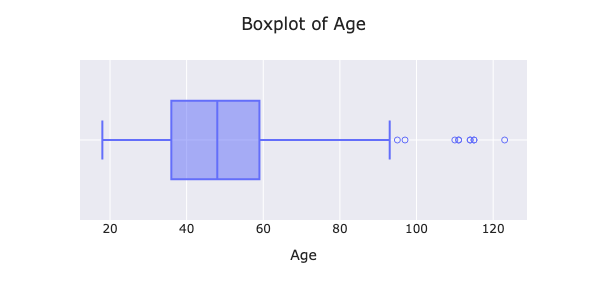

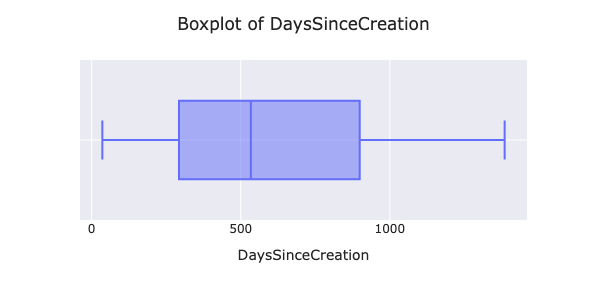

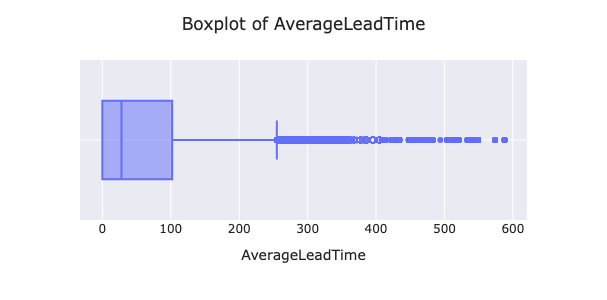

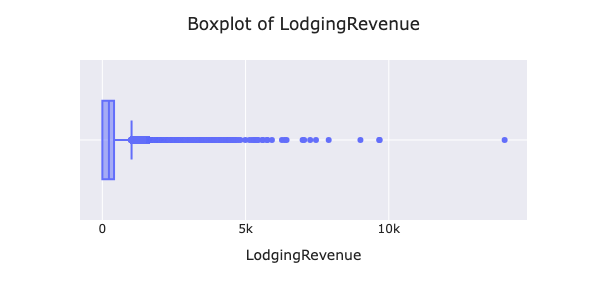

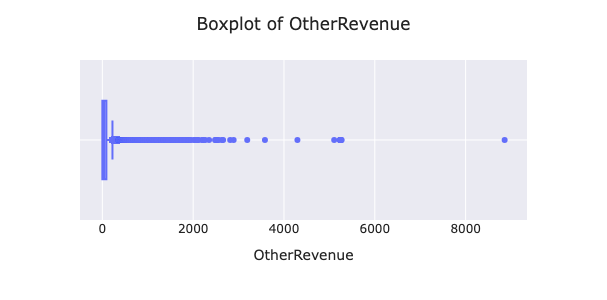

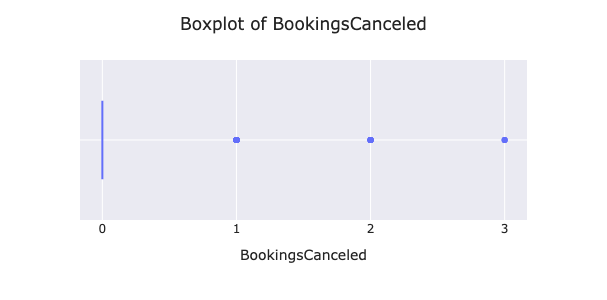

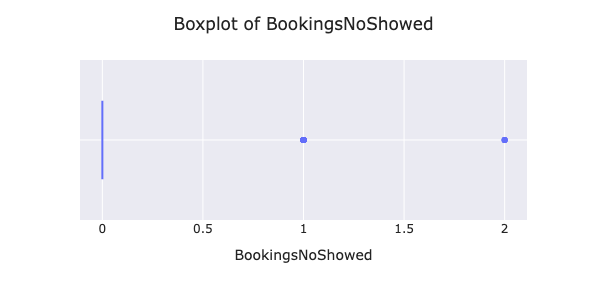

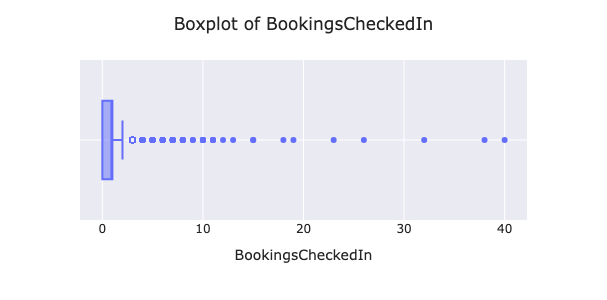

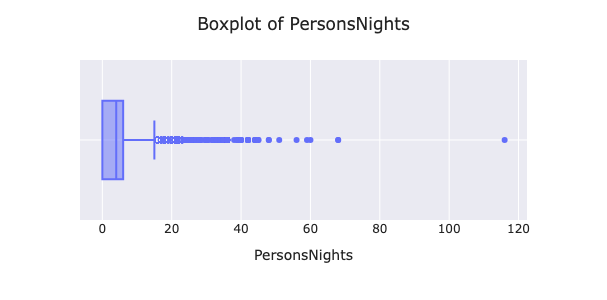

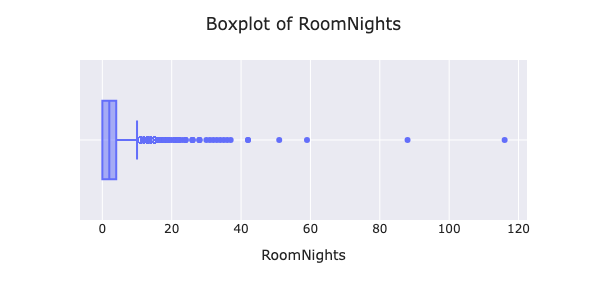

In [57]:
# Loop through each metric feature and generate a horizontal boxplot
for feature in metric_features:
    fig = px.box(df, x=df[feature], color_discrete_sequence=['#636EFA'], 
                 template='seaborn', width=700, height=300, points="suspectedoutliers")
    
    # Add a title to each plot for clarity
    fig.update_layout(title_text=f"Boxplot of {feature}")
    
    # Display the plot
    fig.show()

In [58]:
def manual_method(data):
    """
    function that removes outliers based on the manual filter we defined
    """
    
    # defining the limits to search for outliers
    filter = (
        (df_outlier['Age'] <= 100)
        &
        (df_outlier['AverageLeadTime'] <= 365)
        &
        (df_outlier['LodgingRevenue'] <= 2000)
        &
        (df_outlier['OtherRevenue'] <= 500)
        &
        (df_outlier['PersonsNights'] <= 75)
        &
        (df_outlier['RoomNights'] <= 75)
    )
    
    # applying the filter to our dataframe
    data_filter = data[filter]
    
    return data_filter, filter

In [59]:
# testing our function

df_manual, filter_manual = manual_method(df_outlier)
print('Percentage of data kept after removing outliers:', np.round(df_manual.shape[0] / df_outlier.shape[0] * 100, 4))

Percentage of data kept after removing outliers: 93.996


We will keep the manual filtering for now, and then change it if necessary to improve the performance of the clustering algorithms.

In [60]:
# saving the outliers
outliers = df[~filter_manual]

# keeping the manual method
df_outlier = df_manual.copy()

In [61]:
# saving the dataframe without outliers
df = df_outlier.copy()

### 2.7. New features

In [62]:
def new_features(data, mf):
    """
    function that creates the new features in the dataframe
    """

    data['AveragePersonsPerRoom'] = np.where(data['RoomNights'] != 0, data['PersonsNights'] / data['RoomNights'], 0)
    data['NumberRequests'] = data['SRHighFloor'] + data['SRLowFloor'] + data['SRAccessibleRoom'] + data['SRMediumFloor'] + data['SRBathtub'] + data['SRShower'] + data['SRCrib'] + data['SRKingSizeBed'] + data['SRTwinBed'] + data['SRNearElevator'] + data['SRAwayFromElevator'] + data['SRNoAlcoholInMiniBar'] + data['SRQuietRoom']
    data['NumberBookings'] = data['BookingsCanceled'] + data['BookingsCheckedIn'] + data['BookingsNoShowed']
    data['SpendingPerBooking'] = np.where(data['BookingsCheckedIn'] != 0, (data['LodgingRevenue'] + data['OtherRevenue']) / data['BookingsCheckedIn'], 0)

    # updating the list with the metric and non-metric features
    mf.append('AveragePersonsPerRoom')
    mf.append('NumberRequests')
    mf.append('NumberBookings')
    mf.append('SpendingPerBooking')

    return data, mf

In [63]:
# creating the new features in our dataset
df, metric_features = new_features(df, metric_features)


In order to reduce the high cardinality verified for `Nationality`, we will group some countries according to their region or continent. However, some countries, such as Portugal, France, Great Britain or Germany, will remain separate due to their individual relevance.

Fonts:
* [World Atlas](https://www.worldatlas.com/articles/the-four-european-regions-as-defined-by-the-united-nations-geoscheme-for-europe.html#h_4995447466031620789095766)
* [Country Code Base](countrycodebase.com)

In [64]:
# ATF and PYF to France, because these are territories that belong to France
# GIB and Jey to Great_Britain
# SJM in Norway

FRA_GBR_GER = ["FRA","ATF","PYF", "GBR","GIB","JEY", "DEU"]
Rest_Of_Europe = ["POL","CZE","BLR","UKR","SVK","HUN","MDA","ROU","BGR", "NLD","BEL","LUX","AUT","CHE","AUT","MCO","LIE",
                 "ISL","IRL","NOR","SWE","FIN","DNK","EST","LVA","LTU","SJM","FRO", "ESP","AND","SMR","ITA","MLT","HRV",
                  "SVN","BIH","MNE","SRB","MKD","ALB","GRC","CYP"]
Rest_Of_World = ["AFG","ARM","AZE","BHR","BGD","BTN","BRN","KHM","CHN","CXR","CCK","IOT","GEO","HKG","IND","IDN","IRN","IRQ",
                 "ISR","JPN","JOR","KAZ","KWT","KGZ","LAO","LBN","MAC","MYS","MDV","MNG","MMR","NPL","PRK","OMN","PAK","PSE",
                 "PHL","QAT","SAU","SGP","KOR","LKA","SYR","TWN","TJK","THA","TUR","TKM","ARE","UZB","VNM","YEM","RUS","ASM",
                 "AUS","CXR","CCK","COK","FJI","PYF","GUM","HMD","KIR","MHL","FSM","NRU","NCL","NZL","NIU","NFK","MNP","PLW",
                 "PNG","PCN","WSM","SLB","TKL","TON","TUV","UMI","VUT","WLF","TMP","AIA","ATG","ABW","BRB","BLZ","BMU","BES",
                 "VGB","CAN","CYM","CRI","CUB","CUW","DMA","DOM","SLV","GRL","GRD","GLP","GTM","HTI","HND","JAM","MTQ","MEX",
                 "MSR","ANT","NIC","PAN","PRI","BLM","KNA","LCA","MAF","SPM","VCT","SXM","BHS","TTO","TCA","USA","VIR","ARG",
                 "BOL","BRA","CHL","COL","ECU","FLK","GUF","GUF","GUY","PRY","PER","SUR","URY","VEN","GUY","DZA","AGO","BEN",
                 "BWA","BFA","BDI","CMR","CPV","CAF","TCD","COM","COG","COD","CIV","DJI","EGY","GNQ","ERI","ETH","GAB","GMB",
                 "GHA","GIN","GNB","KEN","LSO","LBR","LBY","MDG","MLI","MWI","MRT","MUS","MYT","MAR","MOZ","NAM","NER","NGA",
                 "REU","RWA","STP","SEN","SYC","SLE","SOM","ZAF","SSD","SDN","SWZ","TZA","TGO","TUN","UGA","ESH","ZMB","ZWE",
                 "ATA"]

In [65]:
def new_nationality(nationality):      
    if nationality in FRA_GBR_GER:     #the ifs and elifs represent the categories.
        return "FRA_GBR_GER"             #the strings are what each value should now.
    elif nationality in Rest_Of_Europe:
        return "Rest_Of_Europe"
    elif nationality in Rest_Of_World:
        return "Rest_Of_World"
    else:
        return nationality
        
# Apply the categorization function to create a new column
df["Nationality"]=df["Nationality"].apply(new_nationality)

In [66]:
df["Nationality"].value_counts()

Nationality
FRA_GBR_GER       38064
Rest_Of_Europe    30976
Rest_Of_World     17263
PRT                8538
Name: count, dtype: int64

### 2.8. Missing Values

In [67]:
# creating a copy to solve missing values' issues
df_mvs = df.copy()

In [68]:
# Checking how many missing values are present in our dataset
df_mvs.isna().sum()

Nationality              0
Age                      0
DaysSinceCreation        0
AverageLeadTime          0
LodgingRevenue           0
OtherRevenue             0
BookingsCanceled         0
BookingsNoShowed         0
BookingsCheckedIn        0
PersonsNights            0
RoomNights               0
DistributionChannel      0
SRHighFloor              0
SRLowFloor               0
SRAccessibleRoom         0
SRMediumFloor            0
SRBathtub                0
SRShower                 0
SRCrib                   0
SRKingSizeBed            0
SRTwinBed                0
SRNearElevator           0
SRAwayFromElevator       0
SRNoAlcoholInMiniBar     0
SRQuietRoom              0
AveragePersonsPerRoom    0
NumberRequests           0
NumberBookings           0
SpendingPerBooking       0
dtype: int64

After many of the steps taken up to this point, our dataset contains no missing values which were probably removed during the previous steps. Either way, we'll double check in other ways.

Checking if there are any missing values but not encoded as NaN but, for exemple, encoded as empty strings or as *'na'*.

In [69]:
# replacing other types of missing values not recognized by pandas with NaN and checking again the number of missing values

missing_values = ['n/a', 'na', '--', '', 'unknown', 'Unknown']

df_mvs.replace(missing_values, np.nan, inplace = True)
df_mvs.isna().sum()

Nationality              0
Age                      0
DaysSinceCreation        0
AverageLeadTime          0
LodgingRevenue           0
OtherRevenue             0
BookingsCanceled         0
BookingsNoShowed         0
BookingsCheckedIn        0
PersonsNights            0
RoomNights               0
DistributionChannel      0
SRHighFloor              0
SRLowFloor               0
SRAccessibleRoom         0
SRMediumFloor            0
SRBathtub                0
SRShower                 0
SRCrib                   0
SRKingSizeBed            0
SRTwinBed                0
SRNearElevator           0
SRAwayFromElevator       0
SRNoAlcoholInMiniBar     0
SRQuietRoom              0
AveragePersonsPerRoom    0
NumberRequests           0
NumberBookings           0
SpendingPerBooking       0
dtype: int64

In [70]:
df = df_mvs

### 2.9. Age Binning


In [71]:
# Bin the different ages in the dataset
df["Age_Bins"] = pd.cut(x=df["Age"], bins=[0, 29, 39, 49, 59, 99], labels=["20-29","30-39","40-49","50-59",">=60"])

# Drop the Age column
df.drop(columns="Age", inplace=True)

# Remove Age from the metric features list
metric_features.remove("Age")

# Append Age bins to the non metric features list
non_metric_features.append("Age_Bins")

### 2.10. Feature Selection

In [72]:
# creating a new copy to perform variable selection

df_corr = df.copy()

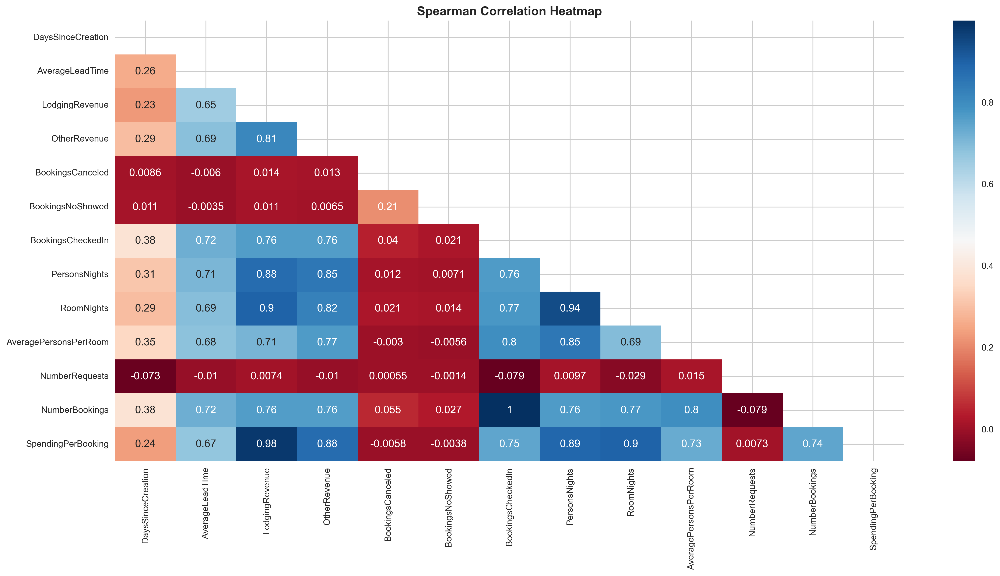

In [73]:
# Checking the correlation Matrix of the variables
plt.figure(figsize=(20,9))
corr = df[metric_features].corr(method ="spearman")
mask = np.triu(np.ones_like(corr, dtype=bool))
sns.heatmap(corr, annot=True, cmap="RdBu", mask=mask)
plt.title("Spearman Correlation Heatmap", fontsize=14, fontweight="bold")
plt.yticks(rotation=0)
plt.show()

Based on the correlation matrix, we made the following decisions to improve the dataset by removing redundant variables while preserving meaningful insights:

1. **Removing `RoomNights`**  
   - `RoomNights` has a very high correlation with `PersonsNights` and `BookingsCheckedIn` (above 0.9).  
   - Since understanding group size is more relevant for segmentation, `PersonsNights` is kept, and `RoomNights` is removed to avoid redundancy.

2. We created the variable `NumberBookings` because we wanted to have a variable that summarized the number of reservations that a customer made with the hotel (independently of them actually happening or not). However, now we can see that this variable is, as expected, highly correlated with `BookingsCheckedIn`, as the majority of the customers do not cancel.

3. **Removing `SpendingPerBooking` Due to High Correlation with `LodgingRevenue`**  
   - `SpendingPerBooking` is almost identical to `LodgingRevenue` (0.98 correlation), meaning it does not add much additional information.  

In [74]:
# dropping the variable based on the correlation

df_corr.drop(['RoomNights', 'AveragePersonsPerRoom', 'NumberBookings','SpendingPerBooking'], axis = 1, inplace = True)

In [75]:
# updating the features lists
metric_features_todrop = ['RoomNights', 'AveragePersonsPerRoom', 'NumberBookings']

metric_features = list(set(metric_features) - set(metric_features_todrop))

**Binary Variables with Low Relevance**

After examining the distribution of **0s and 1s** in the binary variables during the **Data Exploration** phase, we decided that any binary variable with fewer than **1,000 occurrences** of one of its values is not relevant. 

As a result, our team has agreed to remove the following variables:  
`SRShower`, `SRBathtub`, `SRMediumFloor`, `SRAccessibleRoom`, `SRLowFloor`, `SRNearElevator`, `SRAwayFromElevator`, and `SRNoAlcoholInMiniBar`.

In [76]:
binaries_deleate = ["SRShower","SRBathtub","SRMediumFloor","SRAccessibleRoom","SRLowFloor","SRNearElevator","SRAwayFromElevator","SRNoAlcoholInMiniBar"]


# Remove the features from the DataFrame if they exist
df_corr.drop(columns=[col for col in binaries_deleate if col in df_corr.columns], inplace=True)

# Remove the features from non_metric_features if they exist
non_metric_features = [col for col in non_metric_features if col not in binaries_deleate]


**Join Revenues**

In [77]:
# Creating a new feature that will be the sum of the revenues

df_corr["Total_Revenue"] = df_corr["LodgingRevenue"] + df_corr["OtherRevenue"]

# Removing the 2 features from the dataset
df_corr.drop(["LodgingRevenue","OtherRevenue"],axis=1, inplace=True)

# Removing the 2 features from the metric_features list

for i in ["LodgingRevenue","OtherRevenue"]:
    metric_features.remove(i)

# Append the new feature created to the metric_features list
metric_features.append("Total_Revenue")

In [78]:
df_corr.info()

<class 'pandas.core.frame.DataFrame'>
Index: 94841 entries, 1 to 111733
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   Nationality          94841 non-null  object  
 1   DaysSinceCreation    94841 non-null  int64   
 2   AverageLeadTime      94841 non-null  int64   
 3   BookingsCanceled     94841 non-null  int64   
 4   BookingsNoShowed     94841 non-null  int64   
 5   BookingsCheckedIn    94841 non-null  int64   
 6   PersonsNights        94841 non-null  int64   
 7   DistributionChannel  94841 non-null  object  
 8   SRHighFloor          94841 non-null  int64   
 9   SRCrib               94841 non-null  int64   
 10  SRKingSizeBed        94841 non-null  int64   
 11  SRTwinBed            94841 non-null  int64   
 12  SRQuietRoom          94841 non-null  int64   
 13  NumberRequests       94841 non-null  int64   
 14  Age_Bins             94841 non-null  category
 15  Total_Revenue        94

In [79]:
df = df_corr.copy()

In [80]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 94841 entries, 1 to 111733
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   Nationality          94841 non-null  object  
 1   DaysSinceCreation    94841 non-null  int64   
 2   AverageLeadTime      94841 non-null  int64   
 3   BookingsCanceled     94841 non-null  int64   
 4   BookingsNoShowed     94841 non-null  int64   
 5   BookingsCheckedIn    94841 non-null  int64   
 6   PersonsNights        94841 non-null  int64   
 7   DistributionChannel  94841 non-null  object  
 8   SRHighFloor          94841 non-null  int64   
 9   SRCrib               94841 non-null  int64   
 10  SRKingSizeBed        94841 non-null  int64   
 11  SRTwinBed            94841 non-null  int64   
 12  SRQuietRoom          94841 non-null  int64   
 13  NumberRequests       94841 non-null  int64   
 14  Age_Bins             94841 non-null  category
 15  Total_Revenue        94

### 2.11. Encoding


Since `Age_Bins` consists of non-ordinal categories, and both `DistributionChannel` and `Nationality` lack any inherent hierarchy, we will use One-Hot Encoding for these three variables. While this will significantly increase the number of features, we plan to apply PCA later for dimensionality reduction, so it should not hinder our ability to form clusters.  

Additionally, for `DistributionChannel`, we will group the least frequent categories—those accounting for less than 10% of total observations—into a single category called "Other." This will combine the "Corporate" and "GDS Systems" channels, as their individual contribution to the dataset is minimal.




In [81]:
cols = ['Age_Bins', 'Nationality']
ce_one_hot = ce.OneHotEncoder(cols = cols, use_cat_names=True)
df = ce_one_hot.fit_transform(df)

Note: The following code was adapted from the demonstration provided in class.

In [82]:
def one_hot(s, threshold,prefix):
    """Do one-hot encoding for categories above a threshold and create a dummy column for all others named "Other"

    Args:
        s (series): series to apply the transformation
        threshold (numerical): threshold above which a dummy column should be created (from 0 to 1, corresponding from 0 to 100%)
        prefix (string): prefix to assign to the created columns

    Returns:
        dataframe: dataframe with the applied transformations 
    """
    # Check dummies for the column
    d = pd.get_dummies(s)

    # Check if percentage is below threshold and act accordingly
    f = pd.value_counts(s, sort=False, normalize=True) < threshold
    if f.sum() == 0:
        newSeries=d
    else:
        newSeries=d.loc[:, ~f].join(d.loc[:, f].sum(1).rename('Other'))
    # Add the prefix and return the result    
    newSeries=newSeries.add_prefix(prefix)
    return newSeries

In [83]:
# One hot encoding of all categories above 10% - all others categories to "Other"
cols = ['DistributionChannel']
for i in range(len(cols)):
    colToProcess = df[cols[i]].astype(str)
    procDF = one_hot(colToProcess, .1,cols[i]+'_')
    df.drop(columns=cols[i], inplace=True)
    df = pd.concat([df, procDF], axis=1)

In [84]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 94841 entries, 1 to 111733
Data columns (total 25 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   Nationality_PRT                            94841 non-null  int64  
 1   Nationality_FRA_GBR_GER                    94841 non-null  int64  
 2   Nationality_Rest_Of_World                  94841 non-null  int64  
 3   Nationality_Rest_Of_Europe                 94841 non-null  int64  
 4   DaysSinceCreation                          94841 non-null  int64  
 5   AverageLeadTime                            94841 non-null  int64  
 6   BookingsCanceled                           94841 non-null  int64  
 7   BookingsNoShowed                           94841 non-null  int64  
 8   BookingsCheckedIn                          94841 non-null  int64  
 9   PersonsNights                              94841 non-null  int64  
 10  SRHighFloor               

### 2.12. Scaling

Since our dataset has already undergone an initial outlier removal process, we determined that using MinMaxScaler for scaling our numerical variables is a safe choice. This method minimizes the risk of distorting the original data distribution. Additionally, we opted for MinMaxScaler to maintain the relative distances between data points, which is particularly useful for K-means clustering. Given that most of our variables do not follow a normal distribution—except for `Age`, which has now been categorized into bins—StandardScaler would not be the most suitable option.








In [85]:
df_before_scaling = df.copy(deep = True)

df.reset_index(drop=True, inplace=True)
df_before_scaling.reset_index(drop=True, inplace=True)

Using MinMax Scaling on all features, including both numerical and binary variables, will not alter the binary ones. They will remain either 0 or 1, as the scaling process only adjusts continuous values within a specified range without affecting discrete binary categories.


In [86]:
scaler = MinMaxScaler()
scaler.fit(df)
df = pd.DataFrame(scaler.transform(df),columns = df.columns)


In [87]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Nationality_PRT,94841.0,0.090024,0.286218,0.0,0.000000,0.000000,0.000000,1.0
Nationality_FRA_GBR_GER,94841.0,0.401345,0.490173,0.0,0.000000,0.000000,1.000000,1.0
Nationality_Rest_Of_World,94841.0,0.182020,0.385863,0.0,0.000000,0.000000,0.000000,1.0
Nationality_Rest_Of_Europe,94841.0,0.326610,0.468976,0.0,0.000000,0.000000,1.000000,1.0
DaysSinceCreation,94841.0,0.411361,0.274512,0.0,0.184581,0.359526,0.631579,1.0
AverageLeadTime,94841.0,0.167870,0.212933,0.0,0.000000,0.074176,0.271978,1.0
BookingsCanceled,94841.0,0.000250,0.010982,0.0,0.000000,0.000000,0.000000,1.0
BookingsNoShowed,94841.0,0.000079,0.006694,0.0,0.000000,0.000000,0.000000,1.0
BookingsCheckedIn,94841.0,0.050274,0.033329,0.0,0.000000,0.066667,0.066667,1.0
PersonsNights,94841.0,0.094041,0.092657,0.0,0.000000,0.083333,0.125000,1.0


## 3. PCA

Note: The code in this chapter was adapted from the example provided in class.

In [88]:
# Fit the PCA algorithm to data 
pca = PCA().fit(df)

# Show the variance per component
pcaevr = ['{:f}'.format(item) for item in pca.explained_variance_ratio_]
pcaDF = pd.DataFrame({'Component': range(1, len(df.columns)+1),
                      'Variance explained': pcaevr,
                      'Cumulative variance explained': np.cumsum(pca.explained_variance_ratio_)})
pcaDF

,Component,Variance explained,Cumulative variance explained
0,1,0.151080,0.151080
1,2,0.120187,0.271267
2,3,0.100986,0.372253
3,4,0.099616,0.471869
4,5,0.090807,0.562676
5,6,0.082312,0.644988
6,7,0.076885,0.721873
7,8,0.057167,0.779040
8,9,0.049767,0.828807
9,10,0.041851,0.870658


Text(0.5, 1.0, 'Explained variance by components')

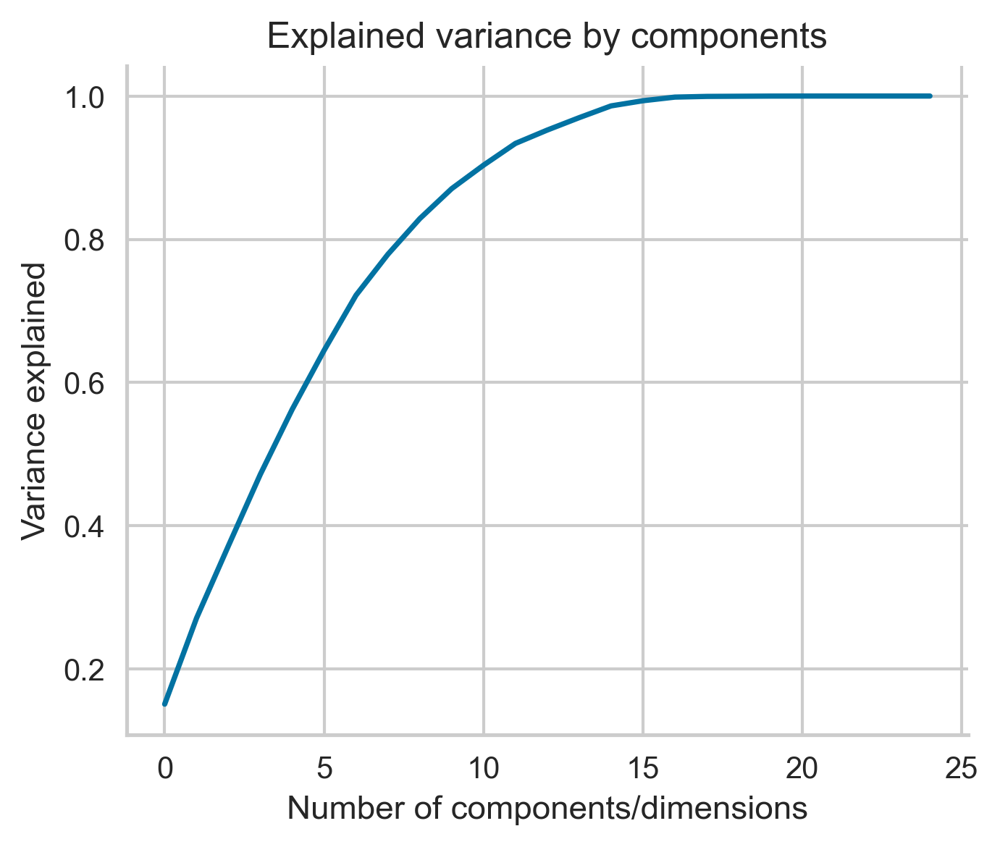

In [89]:
# Plot the cumulative explained variance

# Draw
fig , ax = plt.subplots(figsize=(5, 4))
plt.plot(np.cumsum(pca.explained_variance_ratio_))

# Decoration
sns.despine()
plt.xlabel('Number of components/dimensions')
plt.ylabel('Variance explained')
plt.rc('axes', labelsize=10)
plt.title('Explained variance by components', fontsize=12)

In [90]:
explained_variance_15 = np.cumsum(pca.explained_variance_ratio_)[14]
print(f"Explained variance with 15 components: {explained_variance_15:.2%}")


Explained variance with 15 components: 98.62%


By using the first 15 components, it is possible to explain 98,62% of the variance, so this is the value we are going to proceed with.

## 4. Clustering

### 4.1. K-Means

Note: Part of the code from this chapter was adapted from the example provided in the practical class.

In [91]:
pca_reduced = PCA(n_components = 15)
pca_reduced.fit(df)
df_pca_reduced = pca_reduced.transform(df) 
print(df_pca_reduced.shape)

(94841, 15)


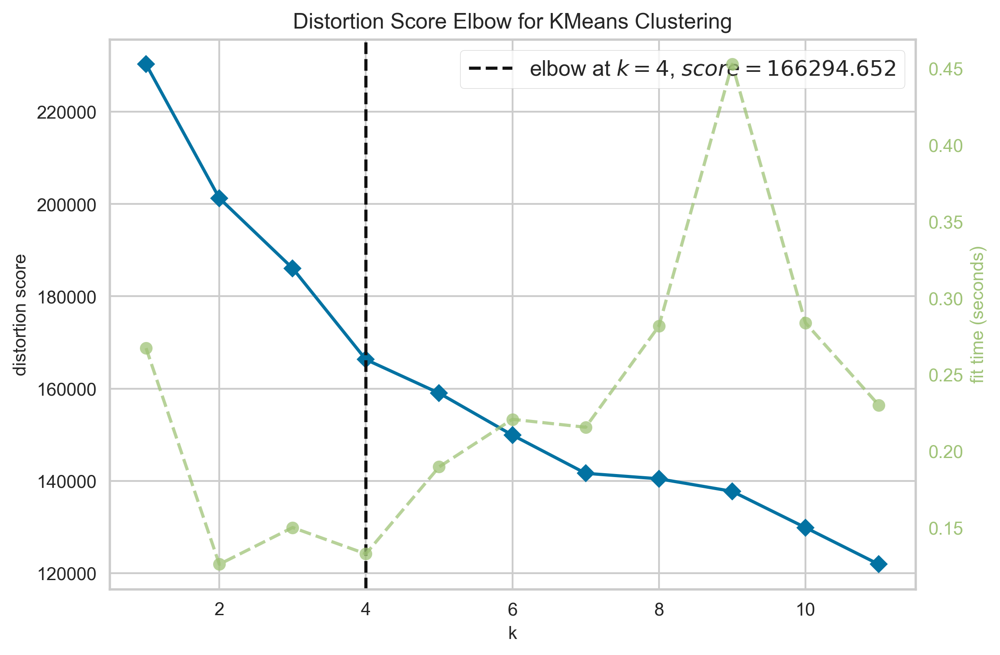

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [92]:
km = KMeans(random_state=43)
visualizer = KElbowVisualizer(km, k=(1,12), random_state=43)
visualizer.fit(df_pca_reduced)
visualizer.show()

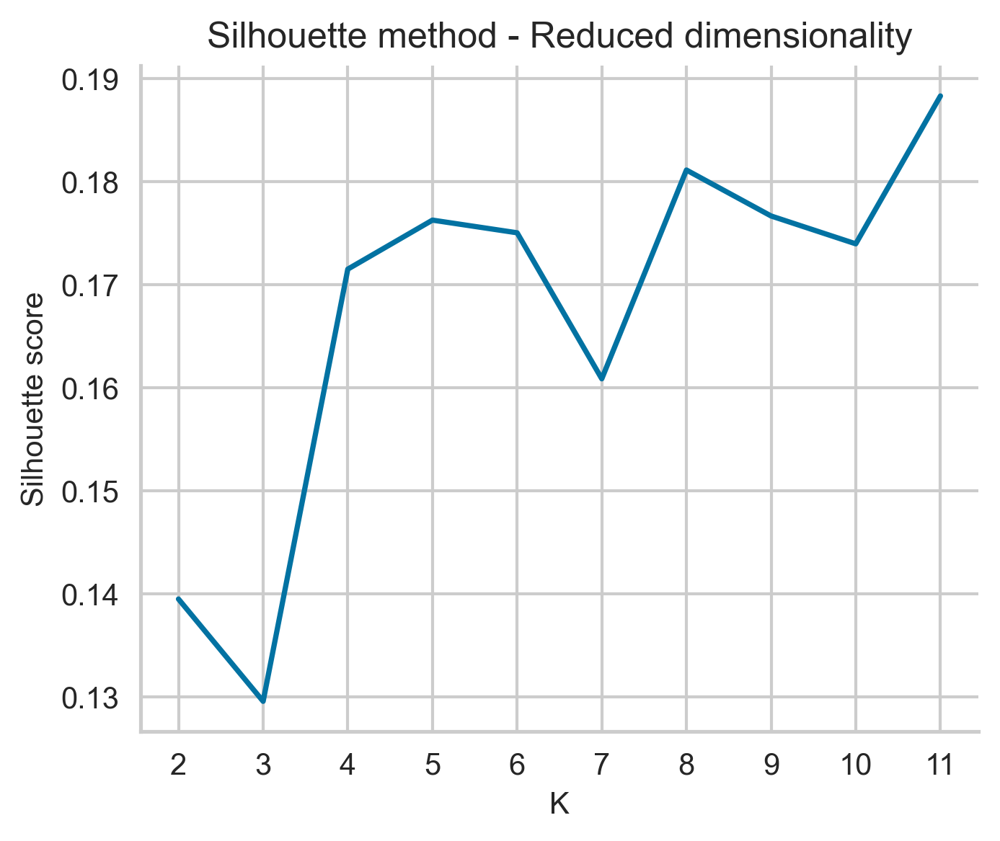

In [93]:
# Select K based on the Silhouette method
sil = []

# Dissimilarity can only be measured in more than 1 partition, therefore it starts on K=2
for k in range(2, 12):
    km = KMeans(n_clusters = k, random_state=43).fit(df_pca_reduced)
    labels = km.labels_
    sil.append(silhouette_score(df_pca_reduced, labels, metric = 'euclidean'))

# Show Results
# Draw
fig , ax = plt.subplots(figsize=(5, 4))
plt.plot(range(2, 12), sil, 'bx-')

# Decoration
sns.despine()
fmt = "{x:,.2f}"
tick = ticker.StrMethodFormatter(fmt)
ax.yaxis.set_major_formatter(tick)
plt.xlabel('K')
plt.ylabel('Silhouette score')
plt.rc('axes', labelsize=10)
ax.xaxis.set_major_locator(ticker.MaxNLocator(integer=True))
plt.title('Silhouette method - Reduced dimensionality', fontsize=12);

The Elbow method indicates K should be 4, but the Silhouette method points to higher values such 11. However, since large number of clusters are not very helpful for marketing pruposes, let's select K as 4

In [94]:
kmeans = KMeans(n_clusters=4, random_state=43,init='k-means++', n_init=15)
allDistances = kmeans.fit_transform(df_pca_reduced)
y_kmeans = kmeans.predict(df_pca_reduced)

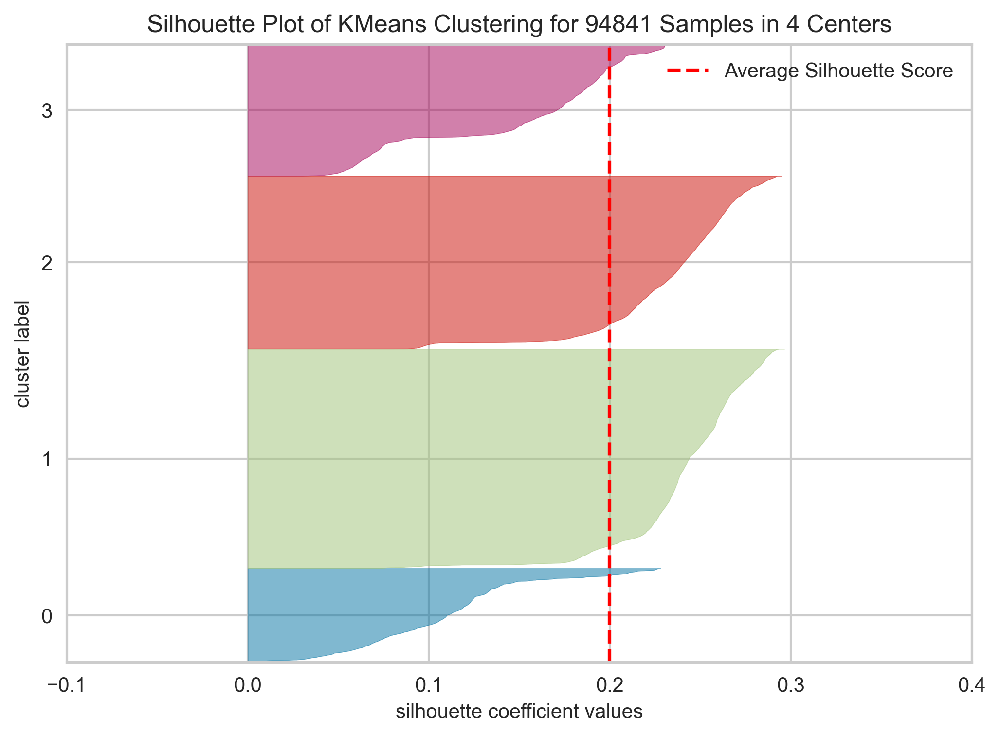

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 94841 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [95]:
# Visualize Silhouette - see https://www.scikit-yb.org/en/latest/api/cluster/silhouette.html
visualizer = SilhouetteVisualizer(kmeans, colors='yellowbrick')
visualizer.fit(df_pca_reduced)
visualizer.show()

In [96]:
kmeans = KMeans(n_clusters=5, random_state=43,init='k-means++', n_init=15)
allDistances = kmeans.fit_transform(df_pca_reduced)
y_kmeans = kmeans.predict(df_pca_reduced)

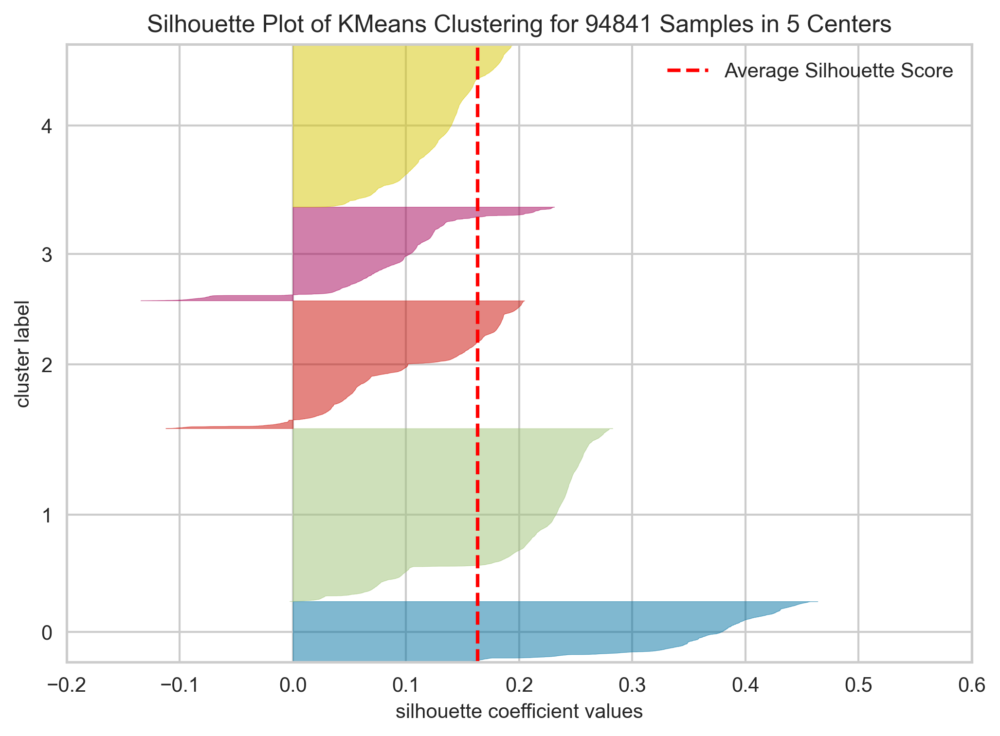

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 94841 Samples in 5 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [97]:
# Visualize Silhouette - see https://www.scikit-yb.org/en/latest/api/cluster/silhouette.html
visualizer = SilhouetteVisualizer(kmeans, colors='yellowbrick')
visualizer.fit(df_pca_reduced)
visualizer.show()

- All clusters have **positive silhouette scores**, meaning there are no clearly misclassified points.
- The **average silhouette score is low (~0.2)**, suggesting weak separation between clusters.
- The dataset is **unbalanced**, with **red and green clusters** having the largest number of samples, while **pink and blue clusters** are smaller.
- The **blue cluster** appears to have the smallest representation, possibly indicating a niche or less frequent pattern.

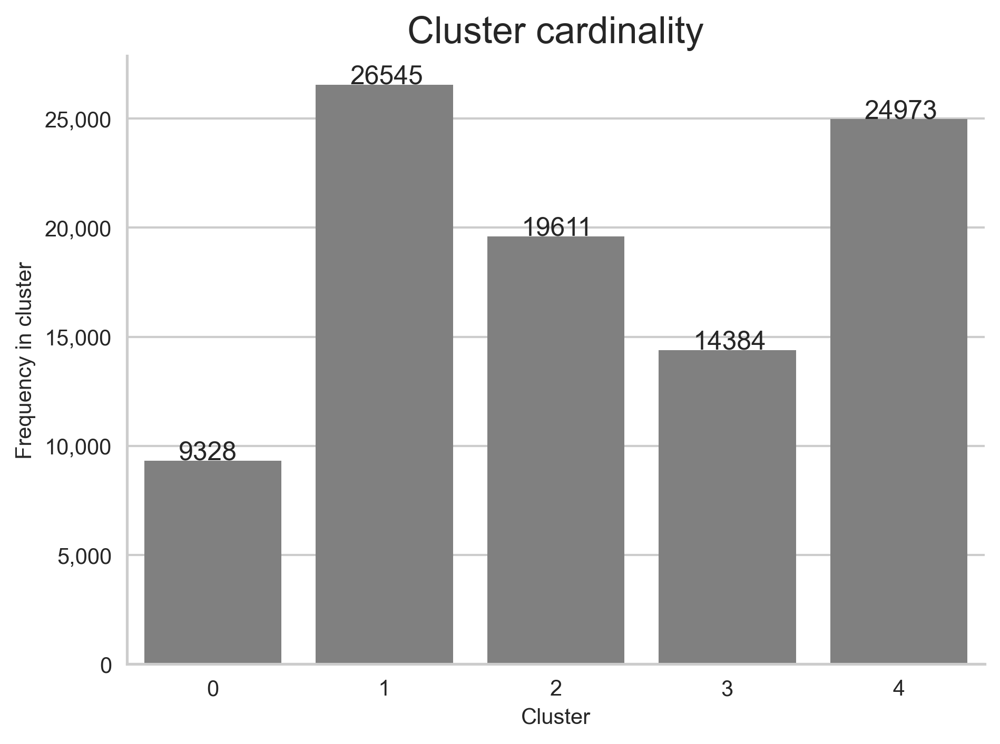

In [98]:
# Plot clusters cardinality 

# Count observations per cluster
freqByCluster = df_before_scaling.groupby(y_kmeans).size()

# Draw
fig, ax = plt.subplots(figsize=(7,5))
g = sns.countplot(x=y_kmeans, color='grey')

# Decoration
fmt = "{x:,.0f}"
tick = ticker.StrMethodFormatter(fmt)
ax.yaxis.set_major_formatter(tick)
for index,data in enumerate(freqByCluster):
    plt.text(x=index-0.2 , y=data+50 , s=f"{data}")
sns.despine()
plt.title("Cluster cardinality", fontsize=17)
plt.xlabel("Cluster")
plt.ylabel("Frequency in cluster")
plt.rc('axes', labelsize=10)

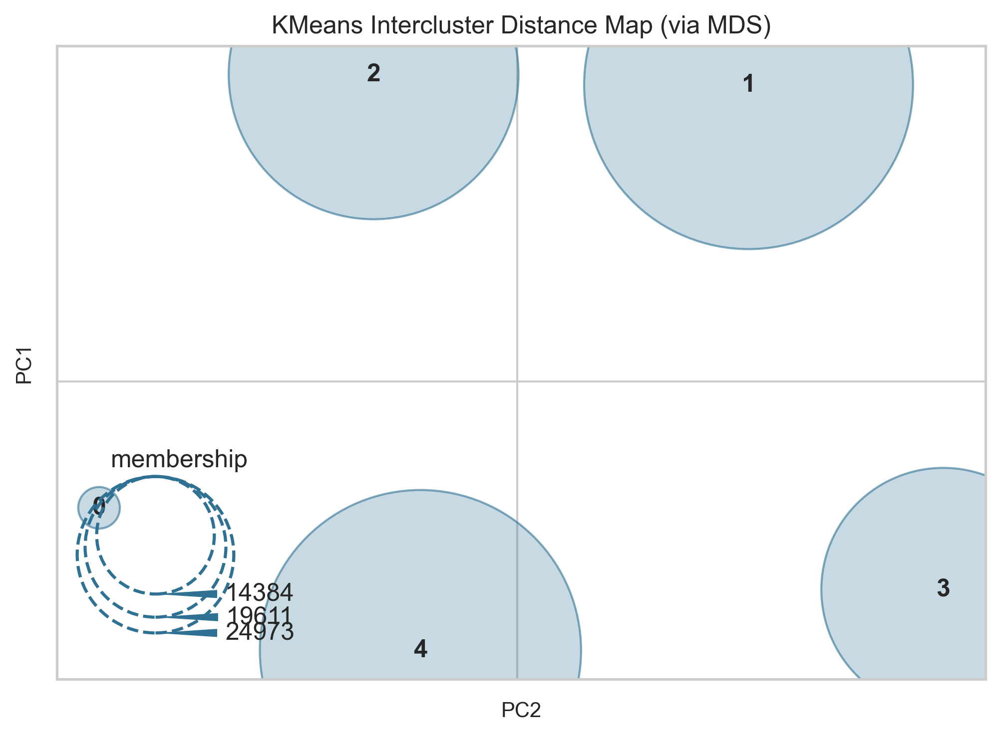

<Axes: title={'center': 'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>

In [99]:
# Visualizing the clusters sizes and distances in 2D
visualizer = InterclusterDistance(kmeans, random_state=7)
visualizer.fit(df_pca_reduced)
visualizer.show()

In [100]:
# Create a dataframe with the weights per component
wheightsDF = pd.DataFrame(pca.components_,columns=df.columns)
wheightsDF = wheightsDF.round(6)
wheightsDF

,Nationality_PRT,Nationality_FRA_GBR_GER,Nationality_Rest_Of_World,Nationality_Rest_Of_Europe,DaysSinceCreation,AverageLeadTime,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,SRHighFloor,SRCrib,SRKingSizeBed,SRTwinBed,SRQuietRoom,NumberRequests,Age_Bins_20-29,Age_Bins_30-39,Age_Bins_40-49,Age_Bins_50-59,Age_Bins_>=60,Total_Revenue,DistributionChannel_Direct,DistributionChannel_Travel Agent/Operator,DistributionChannel_Other
0,0.044066,-0.726317,0.056212,0.626039,0.004641,-0.045903,0.000232,0.000062,0.001066,-0.002504,0.002413,0.004146,0.014114,-0.049124,-0.001321,-0.007061,0.002815,0.024034,0.127184,-0.004839,-0.149194,0.003333,0.110176,-0.136793,0.026617
1,0.082987,0.084545,-0.082985,-0.084547,-0.008058,-0.022734,0.000218,0.000115,0.001111,-0.009557,-0.033192,-0.002459,-0.698883,0.157666,-0.104850,-0.171122,0.001398,-0.012993,0.075846,-0.009505,-0.054746,-0.005486,0.418619,-0.478264,0.059645
2,0.108216,0.090627,0.043839,-0.242682,-0.021402,-0.072726,0.000608,0.000171,0.000489,-0.003686,0.028414,0.017294,0.494155,-0.384283,0.009458,0.043275,-0.023849,0.110091,0.189177,0.124437,-0.399856,-0.000836,0.365190,-0.400165,0.034975
3,0.080872,-0.277707,0.529793,-0.332958,-0.046097,-0.025458,0.000259,0.000025,-0.002257,-0.018767,0.002237,0.008242,0.097525,0.014202,-0.038672,0.021515,-0.017881,0.065055,0.022081,-0.518844,0.449590,-0.024741,0.120964,-0.134619,0.013655
4,0.024881,-0.199764,0.305330,-0.130446,-0.004741,-0.002008,0.000069,0.000041,-0.000229,-0.005116,-0.004607,-0.007627,-0.005281,-0.001017,-0.000404,-0.004139,-0.038743,-0.063571,-0.647035,0.625761,0.123588,-0.005359,0.090337,-0.098729,0.008392
5,-0.001386,0.052892,-0.147734,0.096228,-0.008284,-0.036672,-0.000234,-0.000110,-0.002569,-0.010387,0.004919,0.026368,-0.009269,0.015807,-0.027749,0.002510,0.069723,0.804098,-0.468958,-0.267998,-0.136866,-0.014960,0.019321,-0.015172,-0.004149
6,-0.057200,0.174701,-0.432193,0.314691,0.011518,0.053984,0.000238,0.000075,0.001113,0.008965,0.012000,-0.006817,0.254070,-0.174336,0.026182,0.030174,0.000222,-0.210993,-0.235562,-0.120989,0.567321,0.016057,0.267430,-0.268791,0.001361
7,-0.011057,0.001671,0.022745,-0.013359,-0.174898,-0.078268,-0.000127,-0.000093,-0.016383,-0.027321,0.024916,-0.005641,0.087316,0.191087,0.011418,0.078462,0.846733,-0.280763,-0.192256,-0.159934,-0.213780,-0.033346,0.058389,-0.036846,-0.021543
8,-0.272137,0.098579,0.082925,0.090633,-0.188638,0.015937,-0.000327,-0.000145,-0.011381,-0.000857,0.103838,0.012097,0.205951,0.693022,0.295982,0.334241,-0.222672,0.080963,0.095916,0.074905,-0.029112,0.013322,0.192022,-0.145685,-0.046337
9,0.777992,-0.202439,-0.364482,-0.211071,0.154491,-0.014619,0.001382,0.000491,0.011297,-0.009909,0.046988,-0.000117,0.106255,0.307712,0.108484,0.144285,-0.037038,-0.015726,-0.013745,0.025759,0.040749,-0.020547,-0.062492,0.010560,0.051932


In [101]:
# Study the weights of component 15
comp = abs(wheightsDF.iloc[14])  ## index 14 is component 15
comp = comp.sort_values(ascending=False)
comp

DistributionChannel_Other                    0.685367
SRHighFloor                                  0.408803
DistributionChannel_Direct                   0.386988
DistributionChannel_Travel Agent/Operator    0.298380
AverageLeadTime                              0.258953
DaysSinceCreation                            0.157250
Total_Revenue                                0.124151
NumberRequests                               0.077873
PersonsNights                                0.056136
SRQuietRoom                                  0.051079
SRTwinBed                                    0.040164
Nationality_PRT                              0.033384
BookingsCheckedIn                            0.032590
SRKingSizeBed                                0.023134
Age_Bins_20-29                               0.018551
Nationality_Rest_Of_World                    0.013279
Nationality_FRA_GBR_GER                      0.012876
Age_Bins_40-49                               0.012841
Nationality_Rest_Of_Europe  

- **Top Influential Features**  
  - `DistributionChannel_Other (0.685)`, `SRHighFloor (0.408)`, `DistributionChannel_Direct (0.308)`, and `AverageLeadTime (0.258)` strongly influence this component.  
  - `Total_Revenue (0.124)` and `NumberRequests (0.078)` indicate a connection to financial and booking behavior.

- **Less Influential Features**  
  - Age groups, nationalities, and booking behaviors (e.g., `BookingsCanceled, BookingsNoShowed`) have minimal impact.


In [102]:
top_features = comp[:30].index
clustersMeanDF = pd.DataFrame(df_before_scaling[top_features].groupby(y_kmeans).mean(),columns=top_features)
clustersMeanDF.transpose()

,0,1,2,3,4
DistributionChannel_Other,0.008469,0.036768,0.027485,0.056243,0.018780
SRHighFloor,0.028409,0.043285,0.045230,0.049221,0.045850
DistributionChannel_Direct,0.000322,0.000000,0.000000,0.943757,0.000000
DistributionChannel_Travel Agent/Operator,0.991209,0.963232,0.972515,0.000000,0.981220
AverageLeadTime,98.872320,61.492183,52.031819,41.232411,65.156529
DaysSinceCreation,598.905553,614.237333,583.086533,542.084469,597.457014
Total_Revenue,317.267501,367.015265,299.916745,338.166974,351.463800
NumberRequests,0.683212,0.735995,0.780225,0.450779,0.705041
PersonsNights,4.455832,4.799435,4.033094,4.114850,4.839707
SRQuietRoom,0.080403,0.114146,0.082097,0.042686,0.102030


In [103]:
df_kmeans = pd.concat((df_before_scaling, pd.Series(y_kmeans, name='labels', index=df.index)), axis=1)
df_kmeans.groupby('labels').mean()

,Nationality_PRT,Nationality_FRA_GBR_GER,Nationality_Rest_Of_World,Nationality_Rest_Of_Europe,DaysSinceCreation,AverageLeadTime,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,SRHighFloor,SRCrib,SRKingSizeBed,SRTwinBed,SRQuietRoom,NumberRequests,Age_Bins_20-29,Age_Bins_30-39,Age_Bins_40-49,Age_Bins_50-59,Age_Bins_>=60,Total_Revenue,DistributionChannel_Direct,DistributionChannel_Travel Agent/Operator,DistributionChannel_Other
labels,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.065502,0.934498,0.000000,0.000000,598.905553,98.872320,0.000107,0.000107,0.751715,4.455832,0.028409,0.001394,0.283555,0.279374,0.080403,0.683212,0.000000,0.000000,0.000000,0.000000,1.000000,317.267501,0.000322,0.991209,0.008469
1,0.000000,0.000000,0.000000,1.000000,614.237333,61.492183,0.000414,0.000000,0.759992,4.799435,0.043285,0.009682,0.393483,0.165003,0.114146,0.735995,0.137578,0.195668,0.250367,0.245508,0.170880,367.015265,0.000000,0.963232,0.036768
2,0.246494,0.000000,0.753506,0.000000,583.086533,52.031819,0.000459,0.000051,0.760696,4.033094,0.045230,0.014941,0.462496,0.165315,0.082097,0.780225,0.116567,0.207741,0.210953,0.206364,0.258375,299.916745,0.000000,0.972515,0.027485
3,0.215031,0.304088,0.172831,0.308051,542.084469,41.232411,0.003268,0.000765,0.760011,4.114850,0.049221,0.022316,0.223721,0.090656,0.042686,0.450779,0.120898,0.210512,0.272595,0.235122,0.160873,338.166974,0.943757,0.000000,0.056243
4,0.000000,1.000000,0.000000,0.000000,597.457014,65.156529,0.000120,0.000080,0.740199,4.839707,0.045850,0.011172,0.391783,0.146438,0.102030,0.705041,0.173107,0.246266,0.248348,0.332279,0.000000,351.463800,0.000000,0.981220,0.018780


## 5.Final Cluster Classifications

### Cluster 0 – "Direct Booking Planners"

- Books directly with the hotel (**highest DistributionChannel_Direct = 0.943**).
- Moderate-high spending and mid-range stays (**Total_Revenue = 338, PersonsNights = 4.1**).
- Primarily middle-aged Europeans (**Nationality_FRA_GBR_GER = 0.30, Age_Bins_40-49 = 0.27**).
- Loyal, very low cancellations and no-shows.
- **Differs most in booking method** (direct vs. agent).

### Cluster 1 – "High-Value Agent-Booked Planners"

- Books exclusively through travel agents/operators (**DistributionChannel_Travel Agent/Operator = 0.984**).
- Highest lead time (**74 days**) and longest account history (**DaysSinceCreation = 593.54**).
- Highest representation from France, Germany, and the UK (**Nationality_FRA_GBR_GER = 1.00**).
- Longer stays and higher requests than Cluster 0.
- **Differs most in nationality and longer planning horizon**.

### Cluster 2 – "Elite High-Spenders via Agents"

- Books through travel agents (**DistributionChannel_Travel Agent/Operator = 0.963**).
- **Highest revenue (367) and longest stays (4.79 nights)**.
- More evenly distributed in nationality (**not dominated by FRA/GBR/GER like Cluster 1**).
- **Highest request rate (NumberRequests = 0.735)**.
- **Differs most in spending and length of stay**.

### Cluster 3 – "International Agent-Booked Loyalists"

- Books through travel agents (**DistributionChannel_Travel Agent/Operator = 0.973**).
- Predominantly from **"Rest of the World" regions** (**Nationality_Rest_Of_World = 0.731**).
- Most balanced across age groups.
- **Strongest preference for king-size beds (SRKingSizeBed = 0.448)**.
- **Differs most in nationality and room preferences**.

---

 Where Do These Clusters Differ the Most?

- **Booking Channel** → Cluster 0 books directly, while Clusters 1, 2, and 3 rely on travel agents.
- **Nationality** → Cluster 1 is dominated by FRA/GBR/GER, Cluster 3 by "Rest of the World", while Clusters 0 and 2 are more mixed.
- **Revenue & Stay Length** → Cluster 2 has the highest revenue and longest stays, while Cluster 0 has the shortest stays and slightly lower spending.
- **Lead Time** → Cluster 1 books the farthest in advance (**74 days**), while Cluster 0 has the shortest planning window (**41 days**).
- **Room Preferences** → Cluster 3 has the strongest preference for king-size beds, while Cluster 0 is the least specific in preferences.
- **Cancellation & No-Show Rates** → All clusters are highly reliable, with very low cancellation and no-show rates.

APAGAR A SEGUIR 
---


---

Meet Daniel – The Direct Booking Planner (Cluster 0)

Daniel is the type of guest who likes to be in control. He doesn’t believe in using travel agencies or third-party platforms. Instead, he prefers to book directly with the hotel, making sure he gets the best rate and direct perks. Unlike Sarah, James, or Aisha, Daniel doesn't need a middleman—he trusts the hotel to give him a good deal.

Daniel is a moderate planner—he books around 41 days in advance, much shorter than Sarah (74 days) or James (61 days), but he still prepares his trips with some anticipation. His stays are also shorter (~4.1 nights) compared to the higher-end travelers like James (~4.8 nights).

He is most often a middle-aged European (frequently from France, Germany, or the UK) and travels for either business or leisure. He rarely cancels and almost always checks in as expected, making him a reliable but independent guest.

💡 How Daniel differs:

Only guest type that books directly (all others use travel agents).
Shorter planning window than Sarah or James.
More independent—doesn’t rely on agencies or premium services.
📌 Hotel Strategy for Daniel:
Encourage him to keep booking directly by offering exclusive loyalty rewards, direct booking discounts, and VIP perks for repeat stays.

Meet Sarah – The High-Value Agent-Booked Planner (Cluster 1

Sarah is a strategic planner and a high-value customer who never books a hotel on her own. Instead, she trusts travel agents to do the work for her, ensuring she gets a seamless experience. Unlike Daniel, who insists on direct booking, Sarah finds peace of mind in having an expert handle her itinerary.

Sarah is extremely organized—she books 74 days in advance, the longest lead time among all clusters. This makes her very different from Daniel, who only plans about half that time. Her trips are also longer (~4.7 nights), and she spends more than Daniel but slightly less than James.

Sarah is exclusively European (from France, Germany, or the UK), making her one of the most regionally concentrated guests. She is also reliable—rarely cancels or no-shows, much like James and Aisha.

💡 How Sarah differs:

Plans the farthest ahead (74 days, longest lead time).
Only books through travel agents, never direct.
Exclusively European (unlike Aisha, who is international).
Highly structured, making her a perfect target for early-bird promotions.
📌 Hotel Strategy for Sarah:
Strengthen travel agency partnerships and offer early-booking incentives and premium packages to reward her advanced planning.

Meet James – The Elite High-Spender via Agents (Cluster 2)

James is the ultimate luxury traveler. He doesn’t just book a hotel—he books an experience. Unlike Daniel, who prioritizes independence, and Sarah, who wants structured planning, James wants the best of the best.

James books through high-end travel agents, ensuring his stays are personalized and premium. While he doesn’t book as early as Sarah (61 days in advance vs. 74), he spends the most per stay and stays the longest (4.8 nights on average).

Unlike Sarah, who is mainly European, James doesn’t belong to one nationality—he could be from anywhere. His higher revenue and luxury preferences make him very different from Daniel, who is a more standard guest. James expects king-size beds, custom services, and VIP treatment.

💡 How James differs:

Highest spender—more than Daniel, Sarah, or Aisha.
Longest stays (~4.8 nights), making him the most valuable guest.
International traveler, not confined to one region like Sarah.
Luxury-focused—expects premium experiences and exclusivity.
📌 Hotel Strategy for James:
Create VIP loyalty programs, offer high-end services, and upsell luxury suites and private experiences.

Meet Aisha – The International Agent-Booked Loyalist (Cluster 3)

Aisha is a frequent traveler who relies on travel agents, much like Sarah and James. However, she is not European like Sarah—instead, she comes from various international regions, making her a globally diverse customer.

She plans ahead (52 days in advance), but not as early as Sarah or James. Her stay length (4.3 nights) is moderate—longer than Daniel but shorter than James. She makes a lot of requests, particularly for king-size beds, making her somewhat similar to James in preferences.

Aisha is one of the most globally distributed guests, unlike Sarah, who is European-focused. She is also extremely reliable—just like James, she almost never cancels or no-shows.

💡 How Aisha differs:

Most internationally diverse customer (unlike Sarah, who is European-only).
Moderate lead time (52 days), falling between Daniel and Sarah.
Prefers king-size beds and customized requests, similar to James.
Highly loyal, making her a great long-term customer.
📌 Hotel Strategy for Aisha:
Create tailored promotions for international travelers, global loyalty programs, and strong partnerships with travel agencies worldwide.



1️⃣ Strategy for Daniel – The Direct Booking Planner (Cluster 0)
💡 Key Traits:
✅ Books directly with the hotel (avoids travel agencies)
✅ Shorter planning window (41 days)
✅ Middle-aged European traveler (France, Germany, UK)
✅ Moderate spending and shorter stays (~4.1 nights)
✅ Loyal but independent—low cancellations and no-shows

🏨 Hotel Strategy:
Since Daniel prefers booking directly, the goal is to reward and retain him while preventing him from shifting to third-party travel platforms.

🔹 Boost Direct Bookings

Offer exclusive direct booking discounts (e.g., 10% off for repeat direct bookers).
Promote member-only perks (e.g., free room upgrades, late check-out).
Highlight “best price guarantee” to reinforce the value of direct reservations.
🔹 Encourage Loyalty

Introduce a loyalty program for repeat direct bookers with rewards after multiple stays.
Send personalized email promotions based on his past bookings.
🔹 Optimize for Business & Short Leisure Stays

Promote flexible cancellation policies for business travelers.
Provide business-friendly amenities (e.g., workspace, high-speed WiFi).
🔹 Differentiate from Travel Agencies

Offer flexible booking modifications and a dedicated support line to make direct booking more attractive.
2️⃣ Strategy for Sarah – The High-Value Agent-Booked Planner (Cluster 1)
💡 Key Traits:
✅ Books exclusively through travel agents
✅ The longest planner—books 74 days in advance
✅ European guest (France, Germany, UK)
✅ Longer stays (~4.7 nights) and high spending
✅ Highly structured and reliable—never cancels

🏨 Hotel Strategy:
Sarah values organization, early planning, and smooth coordination. The best approach is to strengthen partnerships with travel agents and offer early booking incentives.

🔹 Strengthen Travel Agency Partnerships

Offer commission-based incentives for travel agencies to promote the hotel.
Provide exclusive agent-only packages (e.g., VIP upgrades for agency clients).
Organize special events for travel agents to maintain strong relationships.
🔹 Encourage Early Bookings

Discounts for bookings made 3+ months in advance (e.g., 15% off early reservations).
Flexible rebooking options to maintain trust in long-term planning.
Implement pre-paid vacation deals to secure long-term bookings.
🔹 Enhance Guest Experience

Personalize Sarah’s stay with pre-arrival concierge services (e.g., room preferences, activity planning).
Offer exclusive dining experiences or spa discounts to enhance the premium feel of her stay.
3️⃣ Strategy for James – The Elite High-Spender via Agents (Cluster 2)
💡 Key Traits:
✅ Luxury traveler who books through high-end travel agents
✅ Highest spender of all clusters
✅ Long stays (~4.8 nights) and expects premium services
✅ More globally diverse—no dominant nationality
✅ Rarely cancels or no-shows, but expects top-tier treatment

🏨 Hotel Strategy:
James is a VIP guest who prioritizes exclusivity and personalized service. The key is to maximize revenue from his high spending while ensuring he remains loyal to the hotel’s premium offerings.

🔹 Create a VIP Experience

Launch a Luxury Guest Program with priority service, personal concierge, and private check-ins.
Offer exclusive suite upgrades, private lounge access, or chauffeur services.
Introduce a dedicated luxury travel agent concierge to maintain strong relationships with high-end agencies.
🔹 Upsell Premium Services

Promote personalized experiences, such as private dining, helicopter tours, or spa retreats.
Offer luxury packages (e.g., extended-stay discounts, premium transportation services).
🔹 Encourage Repeat Stays

Implement a VIP loyalty program where high-spenders receive bonus perks for booking multiple luxury stays.
Offer priority rebooking for peak seasons to ensure James always gets the best rooms.
🔹 Differentiate the Hotel from Competitors

Focus on exclusive, one-of-a-kind experiences that competitors cannot offer.
Ensure exceptional service—a dedicated butler or concierge for VIP guests can make a lasting impression.
4️⃣ Strategy for Aisha – The International Agent-Booked Loyalist (Cluster 3)
💡 Key Traits:
✅ Books through travel agents (but from non-European regions)
✅ Moderate-high spending and mid-length stays (~4.3 nights)
✅ Strongest preference for king-size beds
✅ Plans ahead (52 days) but not as long as Sarah or James
✅ Extremely reliable—low cancellations and no-shows

🏨 Hotel Strategy:
Aisha is a frequent international traveler who relies on travel agents. The key is to maximize the hotel’s appeal to global guests while ensuring her comfort and convenience.

🔹 Strengthen Global Travel Agency Relationships

Partner with international travel agencies and online booking platforms to attract more guests like Aisha.
Offer translated booking support and multilingual concierge services for non-English-speaking travelers.
Develop country-specific promotions to attract guests from different regions.
🔹 Enhance International Guest Experience

Provide king-size bed guarantees for comfort (since Aisha prefers this).
Offer global dining options to cater to diverse tastes.
Ensure airport transfer services are available for easy arrivals.
🔹 Encourage Repeat Stays

Implement a “Stay Twice, Get a Reward” program to incentivize repeat international guests.
Send personalized offers based on previous stays (e.g., discounted future bookings).
🔹 Differentiate the Hotel for International Travelers

Offer cultural experiences or local tours to make Aisha’s stay more unique.
Ensure a seamless international payment system with multiple currency options.
